In [52]:
import datetime
import calendar
import collections
from operator import itemgetter

import numpy as np
import pandas as pd

# Networks 
import networkx as nx
# Community Detection
import community as community_louvain 
import datetime as datetime
# import pycombo 

# Visualization
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns

# Interactive Maps/Visaualization
import folium
from folium import plugins
import plotly.graph_objects as go


# Modelling 
import sklearn
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import make_regression
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import linear_model, metrics
from sklearn import preprocessing
from sklearn.feature_selection import RFE
from sklearn.tree import DecisionTreeRegressor 
from sklearn import tree
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from nnv import NNV




# Custom Colors
MAGENTA = "#6C3483"
GREEN = "#239B56"
BLUE = "#5DADE2"

In [3]:
# loading database into dataframe
dataframe = pd.read_csv("../database.csv", low_memory=False)
dataframe.head()

,departure,return,departure_id,departure_name,return_id,return_name,distance (m),duration (sec.),avg_speed (km/h),departure_latitude,departure_longitude,return_latitude,return_longitude,Air temperature (degC)
0,2020-03-23 06:09:44,2020-03-23 06:16:26,86,Kuusitie,111.0,Esterinportti,1747.0,401.0,0.261397,60.195245,24.901900,60.197572,24.926781,0.9
1,2020-03-23 06:11:58,2020-03-23 06:26:31,26,Kamppi (M),10.0,Kasarmitori,1447.0,869.0,0.099908,60.168610,24.930537,60.165017,24.949473,0.9
2,2020-03-23 06:16:29,2020-03-23 06:24:23,268,Porolahden koulu,254.0,Agnetankuja,1772.0,469.0,0.226695,60.195540,25.053581,60.187234,25.036412,0.9
3,2020-03-23 06:33:53,2020-03-23 07:14:03,751,Vallipolku,106.0,Korppaanmäentie,7456.0,2406.0,0.185935,60.227827,24.819614,60.203474,24.898930,0.9
4,2020-03-23 06:36:09,2020-03-23 07:04:10,62,Länsisatamankatu,121.0,Vilhonvuorenkatu,7120.0,1679.0,0.254437,60.158928,24.909692,60.186463,24.967872,0.9


## Data processing

In [4]:
# Convert departure and return columns into datetime datatype
dataframe[['departure','return']] =  dataframe[['departure','return']].apply(pd.to_datetime, format='%Y-%m-%d %H:%M:%S.%f')

In [5]:
# Edit columns name
dataframe = dataframe.rename(columns={'distance (m)': 'distance',
                                     'duration (sec.)': 'duration',
                                     'avg_speed (km/h)':'speed',
                                      'Air temperature (degC)':'temperature',
                                     })
                        

In [6]:
# Remove invalid data
dataframe = dataframe[ 
                    (50 < dataframe['distance']) & (dataframe['distance'] < 10000) &
                    (120 < dataframe['duration']) & (dataframe['duration'] <  18000) &
                    (-20 < dataframe['temperature']) & (dataframe['temperature'] < 50)        
                    ]    

In [7]:
# add year and month-year columns
dataframe['month_year'] = dataframe['departure'].dt.to_period('M')
dataframe['year'] = dataframe['departure'].dt.to_period('Y')

In [8]:
# split dataframe into 5 years data 
year_2016 = dataframe[dataframe['departure'].dt.year == 2016]
year_2017 = dataframe[dataframe['departure'].dt.year == 2017]
year_2018 = dataframe[dataframe['departure'].dt.year == 2018]
year_2019 = dataframe[dataframe['departure'].dt.year == 2019]
year_2020 = dataframe[dataframe['departure'].dt.year == 2020]

# create list of years and dataframes
y = list(range(2016,2021))
data_list = [year_2016,year_2017,year_2018,year_2019,year_2020]
# network_list = [y16,y17,y18,y19,y20]


## Exploratory Data Analysis

In [9]:
import matplotlib.pyplot as plt

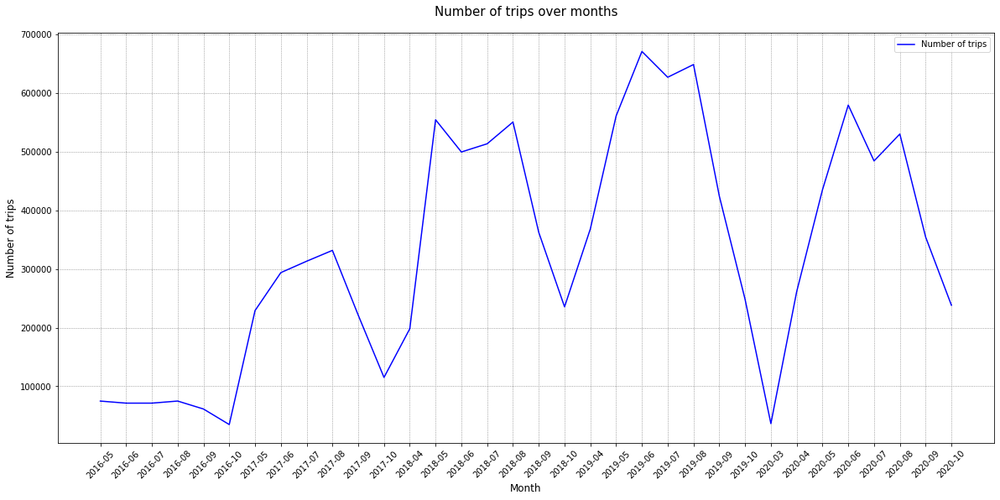

In [10]:
"""Add a trend line to the chart"""
df = dataframe.copy()

df['Month'] = pd.to_datetime(df['departure']).dt.strftime('%Y-%m')
df_by_year = df.groupby(df['Month']).size().reset_index(name='number of trips')

fig, ax = plt.subplots(figsize=(20,9))
plt.plot(df_by_year["Month"], df_by_year["number of trips"], color= 'blue')

ax.set_title("Number of trips over months", fontsize= 15, pad= 20)
ax.set_ylabel("Number of trips", fontsize=12)
ax.set_xlabel("Month", fontsize=12)
plt.xticks(rotation=45)

plt.grid(linestyle=":", color='grey')
plt.legend(["Number of trips"])

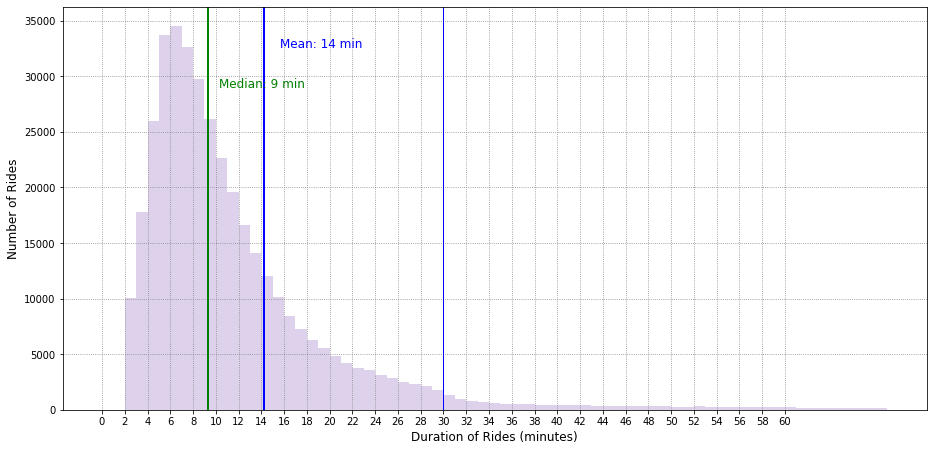

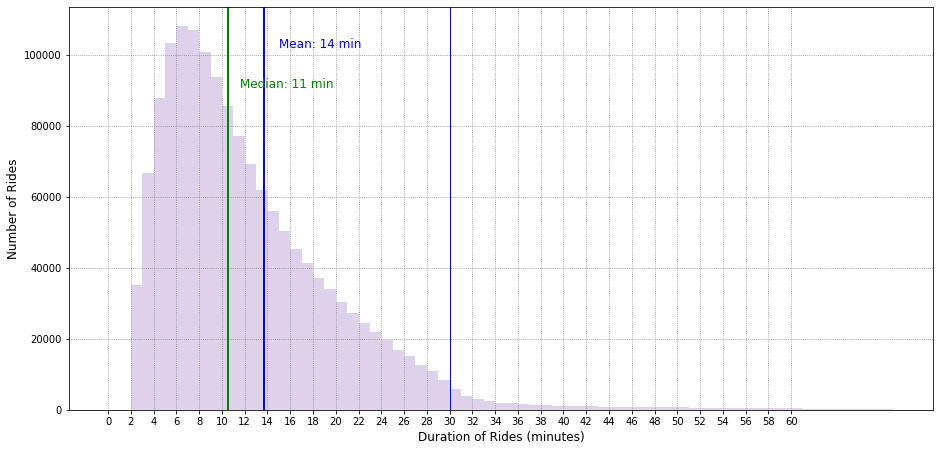

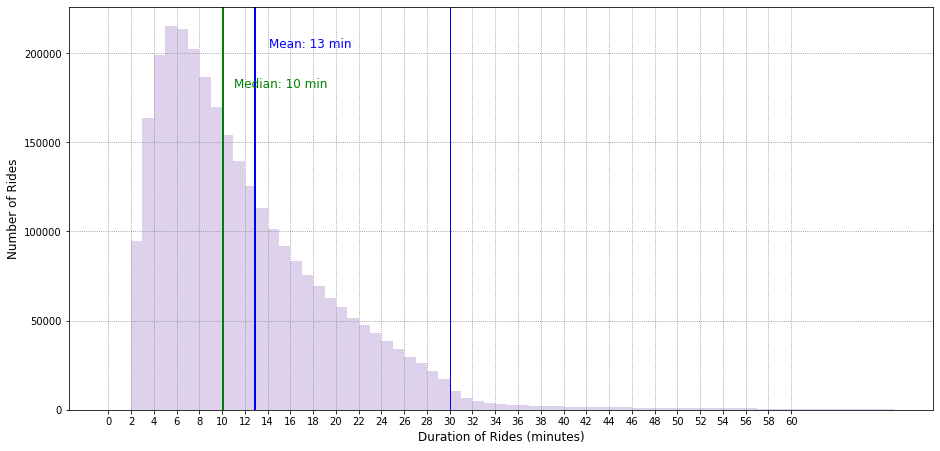

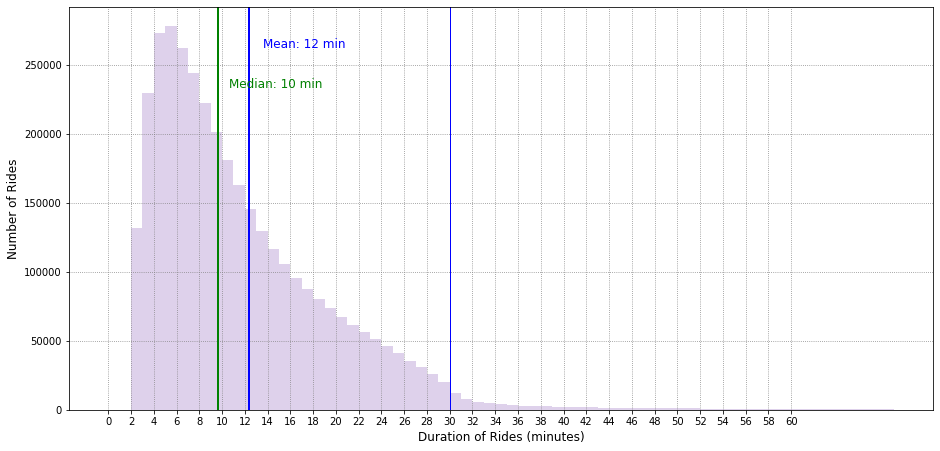

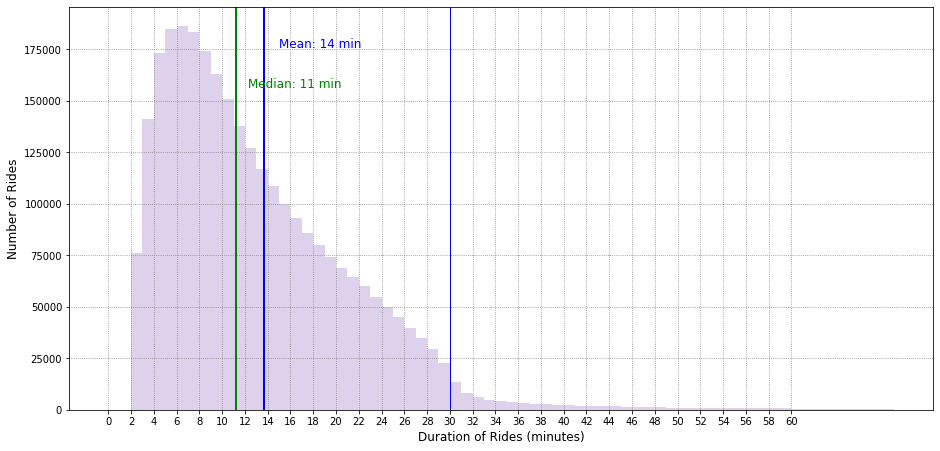

In [11]:
# calculate average duration of trips
def trip_duration(dataframe):

    df = dataframe.copy()
    
    # Converting seconds to minutes
    df["duration"] = df["duration"]/60
    
    # Filtering relevant data
    duration_data = df["duration"]
    fig = plt.figure(figsize=(15,7))
    ax = fig.add_axes([0.1, 0.1, 0.8, 0.8])

    # Ploting the histogram
    plt.hist(duration_data, bins = range(70), color = 'tab:purple', alpha=0.3, histtype ="bar")

    # Adding median and mean lines
    plt.axvline(df["duration"].mean(), color='blue', linestyle='-', linewidth=2 )
    plt.axvline(df["duration"].median(), color='green', linestyle='-', linewidth=2 )
    plt.axvline(x = 30, color="blue", linestyle='-', linewidth=1 )

    # Adding median and mean texts
    min_ylim, max_ylim = plt.ylim()
    plt.text(df["duration"].mean()*1.1, max_ylim*0.9, 'Mean: {:.0f} min'.format(df["duration"].mean()), color = 'blue',  fontsize= 12)
    plt.text(df["duration"].median()*1.1, max_ylim*0.8, 'Median: {:.0f} min'.format(df["duration"].median()), color = 'green', fontsize= 12)
    # plt.text(x= 28,y=200000, s="Free", color = GREEN, fontsize= 12)
    # plt.text(x= 30.5,y=200000, s="Extra Charge", color = "grey", fontsize= 12)

    # Seting ticks on x axis
    ticks =range(0, 62, 2)
    plt.xticks(ticks)
    # Seting ticks on y axis
    ticks =range(0, 3600, 2000)

    # Labeling Axes
    plt.xlabel("Duration of Rides (minutes)", fontsize= 12, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 12)

    # Adding Grid
    plt.grid(linestyle=":", color='grey')

    plt.show()

for i in range(5):
    trip_duration(data_list[i])

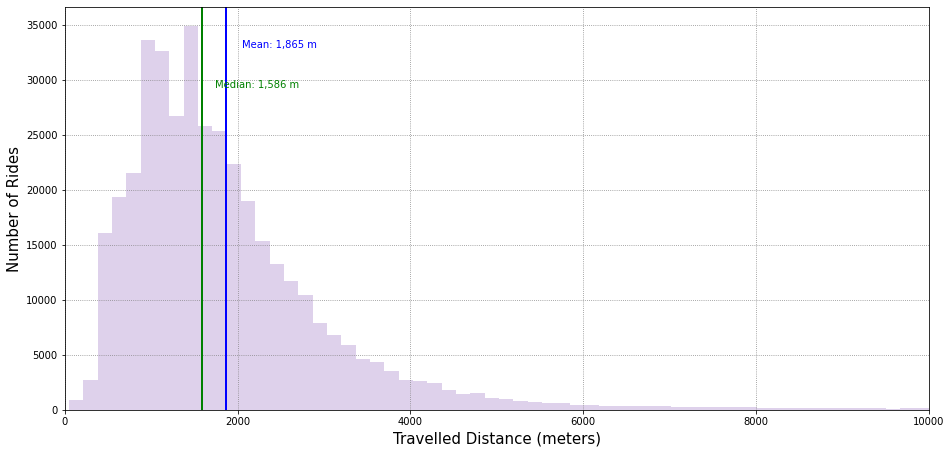

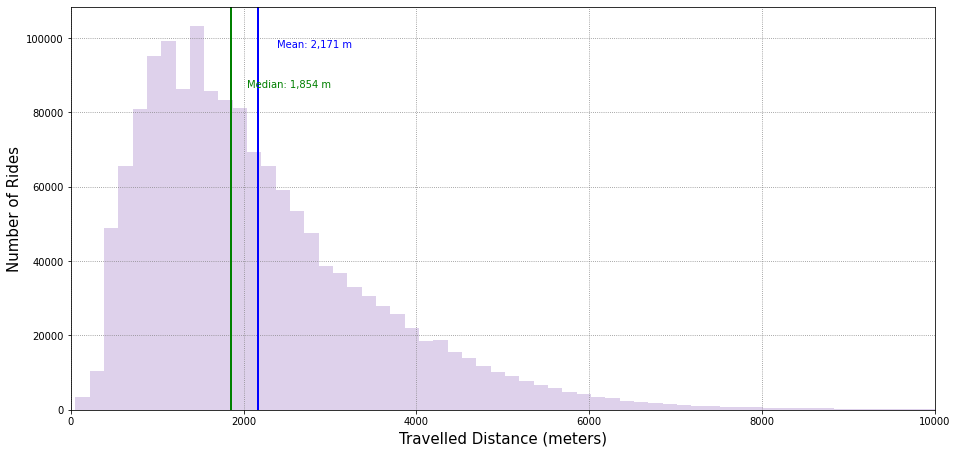

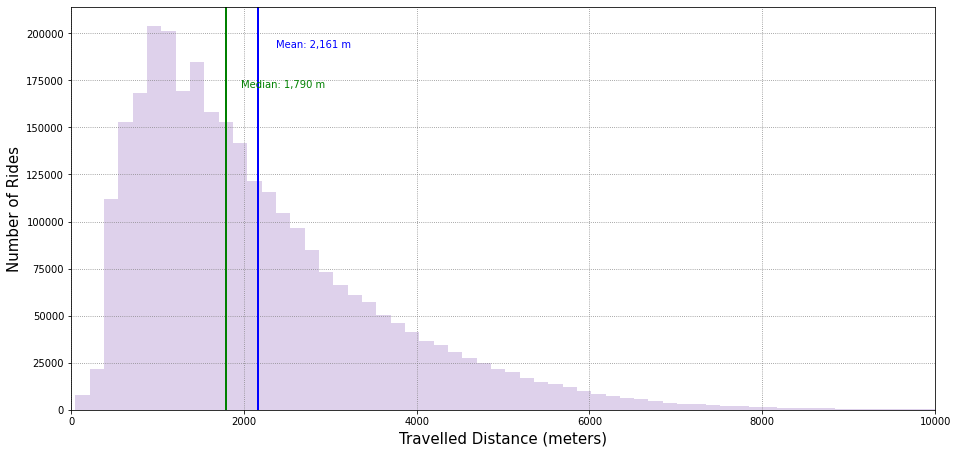

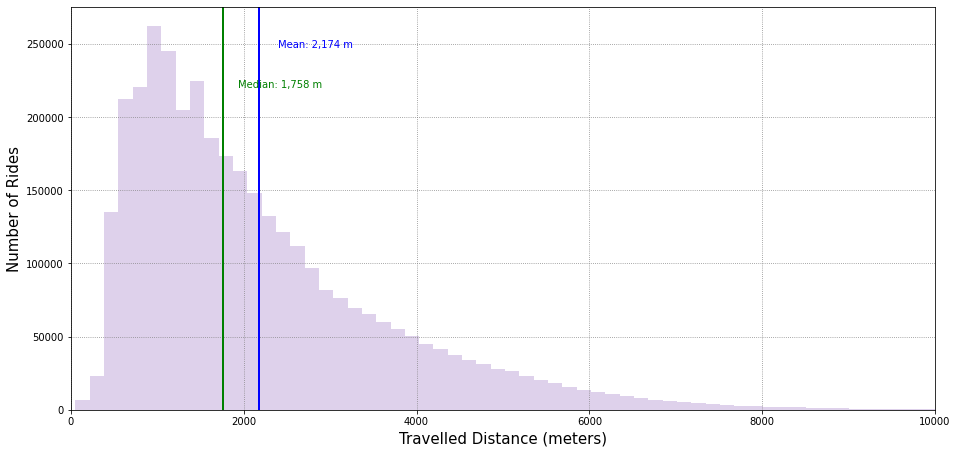

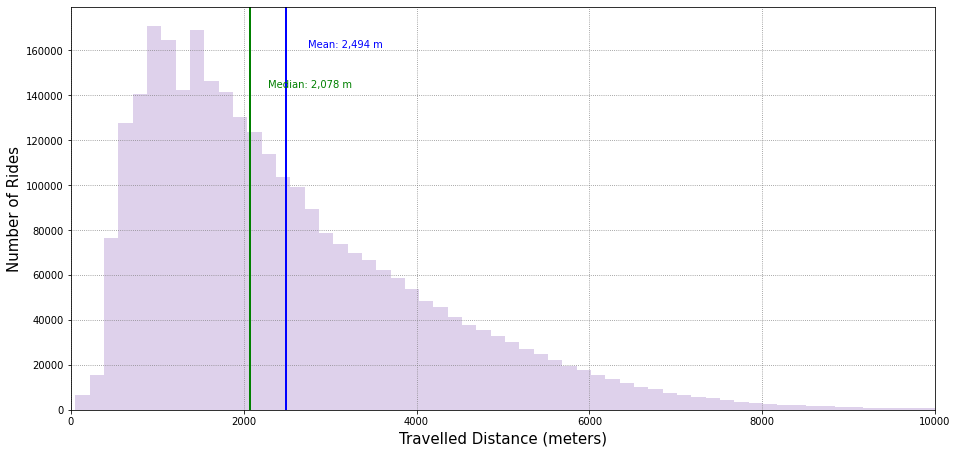

In [12]:
def distance(dataframe):

    df = dataframe.copy()
    
    fig = plt.figure(figsize=(15,7))
    ax = fig.add_axes([0.1, 0.1, 0.8, 0.8])

    data = df["distance"]
    plt.hist(data, bins = 60, color = 'tab:purple', alpha=0.3)
    #plt.scatter(data)


    plt.axvline(df["distance"].mean(), color='blue', linestyle='-', linewidth=2 )
    plt.axvline(df["distance"].median(), color='green', linestyle='-', linewidth=2 )
    plt.axvline(df["distance"].median(), color='green', linestyle='-', linewidth=2 )

    min_ylim, max_ylim = plt.ylim()

    plt.text(df["distance"].mean()*1.1, max_ylim*0.9, 'Mean: {:,.0f} m'.format(df["distance"].mean()), color = 'blue',  fontsize= 10)
    plt.text(df["distance"].median()*1.1, max_ylim*0.8, 'Median: {:,.0f} m'.format(df["distance"].median()), color = 'green', fontsize= 10)

    ax.set_xlim([0,10000])

    # Labeling Axes
    plt.xlabel("Travelled Distance (meters)", fontsize= 15, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 15)

    # Adding Grid
    plt.grid(linestyle=":", color='grey')

    plt.show()

for i in range(5):
    distance(data_list[i])

In [13]:
# create sumamary table about trips distance and duration

df = dataframe.copy()
df['duration'] = df['duration']/60
summary = df.groupby(['year'])['duration','distance'].mean().reset_index()

summary['duration'] = summary['duration'].map('{:,.2f}'.format)
summary['distance'] = summary['distance'].map('{:,.0f}'.format)

summary

<ipython-input-13-516767d3cb77>:5: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  summary = df.groupby(['year'])['duration','distance'].mean().reset_index()


,year,duration,distance
0,2016,14.22,"1,865"
1,2017,13.66,"2,171"
2,2018,12.87,"2,161"
3,2019,12.35,"2,174"
4,2020,13.65,"2,494"


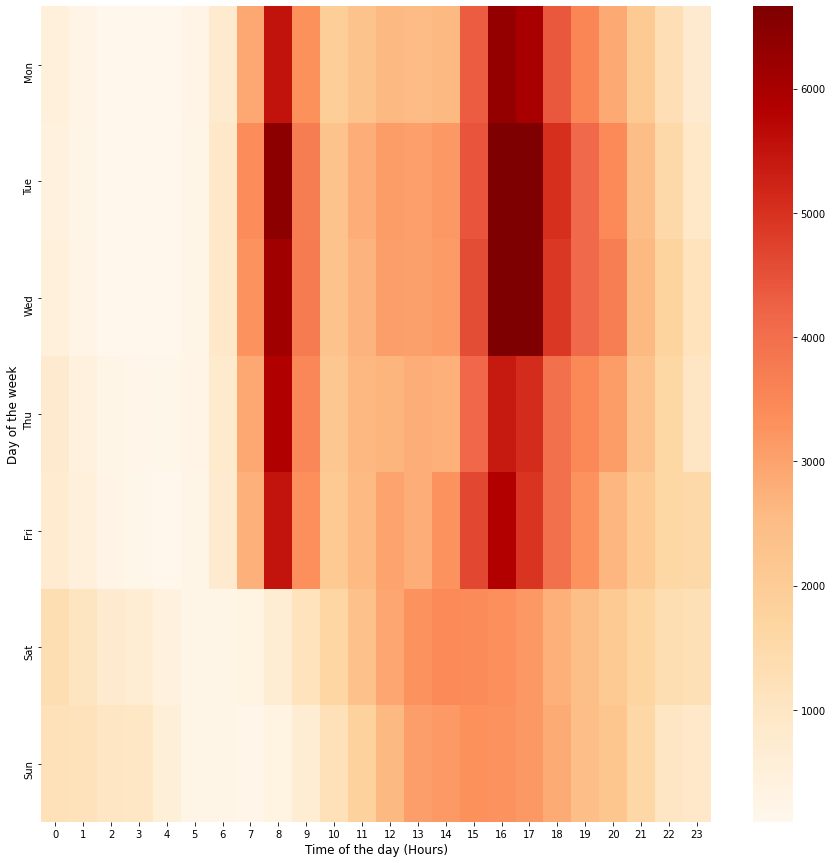

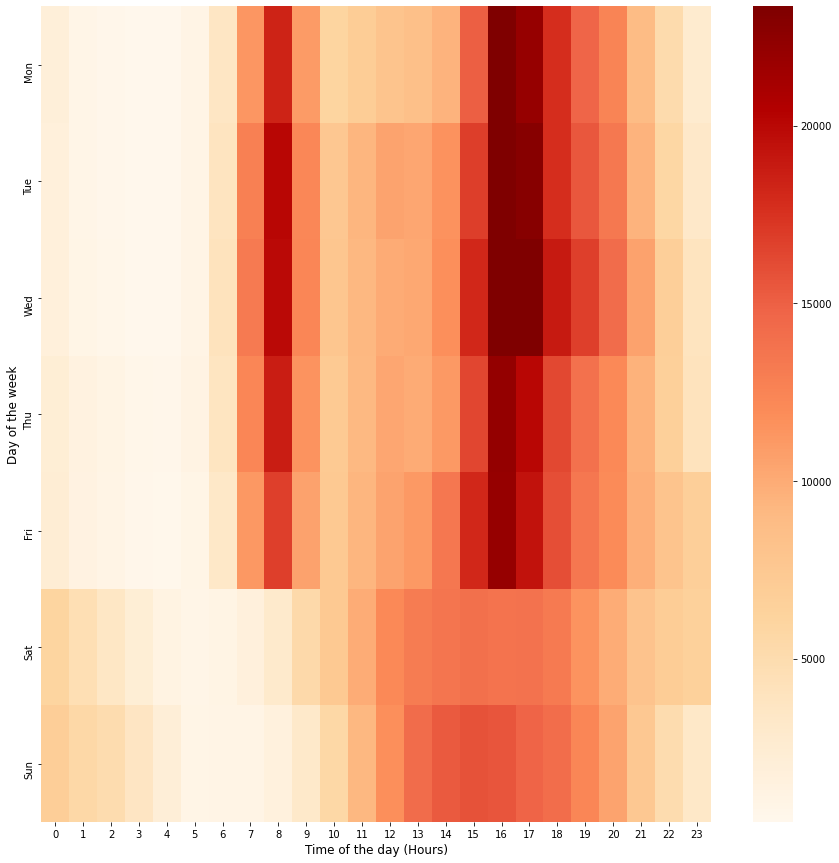

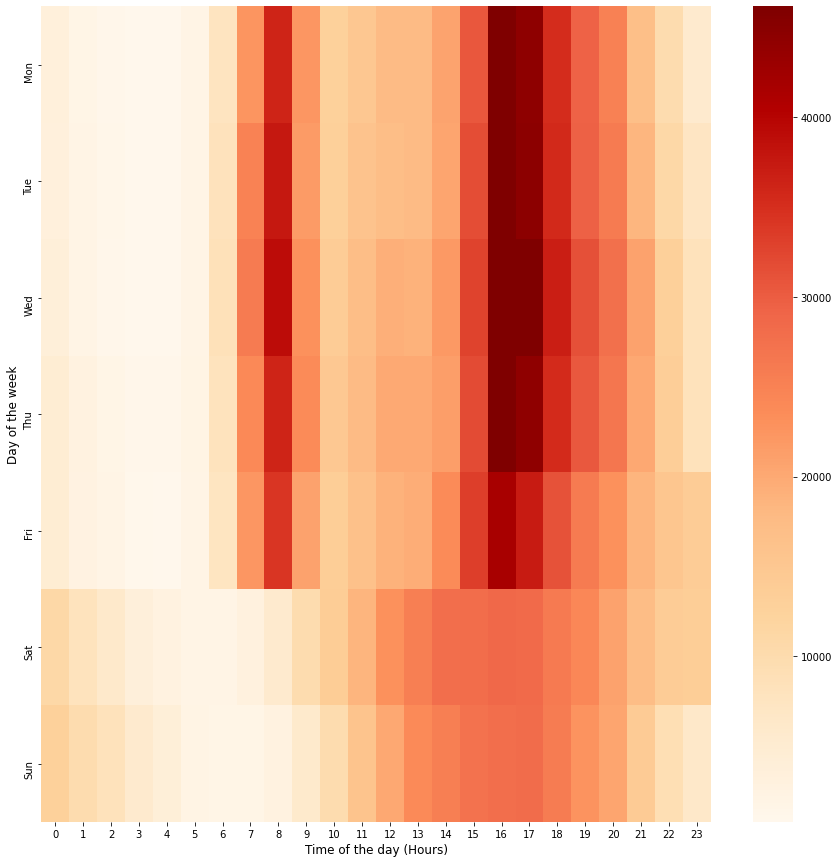

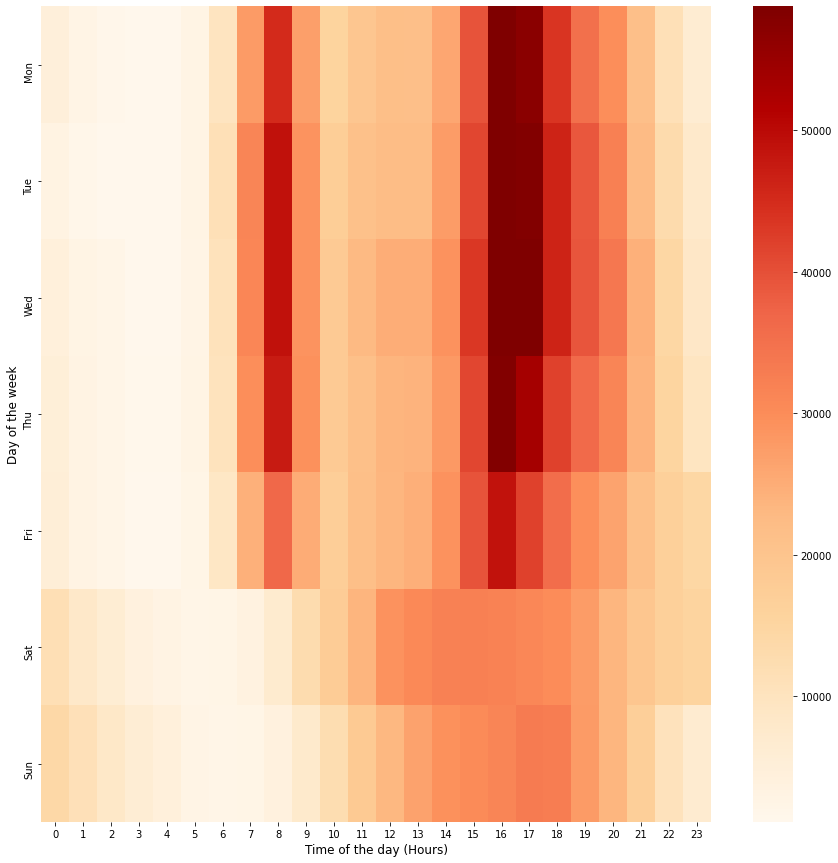

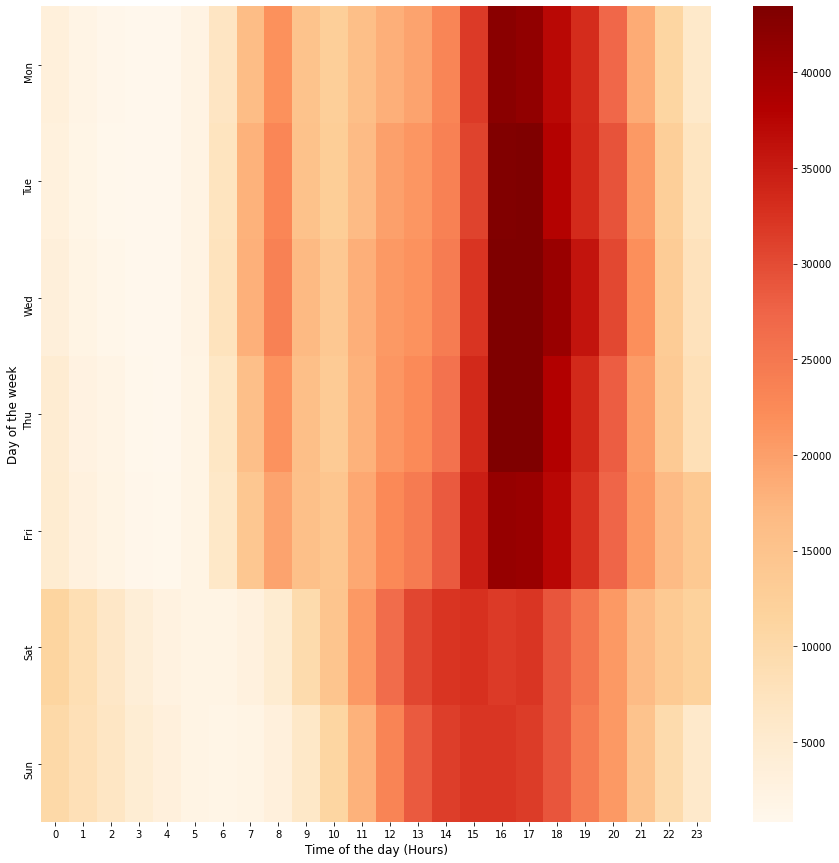

In [14]:
import seaborn as sns
# Heatmap of trips frequency during the week
def weekday_heatmap(dataframe, year):

    weekdays = ["Mon", "Tue","Wed", "Thu", "Fri", "Sat", "Sun"]
    
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    df["hour"] = pd.DatetimeIndex(df['departure']).hour
    df["weekday"] = pd.DatetimeIndex(df['departure']).weekday
    daily_activity = df.groupby(by=['weekday','hour']).count()['departure_name'].unstack()

    # Figure
    fig, ax = plt.subplots(figsize=(15,15))
    sns.heatmap(daily_activity, robust=True, cmap="OrRd", yticklabels=weekdays) # "YlOrBr

    # Labeling Axes
    plt.xlabel("Time of the day (Hours)", fontsize= 12, x = 0.5)
    plt.ylabel("Day of the week", fontsize= 12)


for i in range(5):
    weekday_heatmap(data_list[i],y[i])

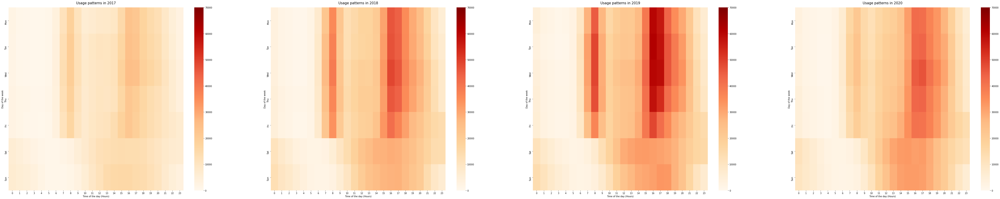

In [15]:
def yearlyHeatmap(dataframe):
    """
    This function plots the number of trips by weekday and hour of the day.
    """
    weekdays = ["Mon", "Tue","Wed", "Thu", "Fri", "Sat", "Sun"]
    
    # Data
    df = dataframe.copy()

    df["hour"] = pd.DatetimeIndex(df['departure']).hour
    df["weekday"] = pd.DatetimeIndex(df['departure']).weekday

    df_2017 = df[df['departure'].dt.year == 2017]
    df_2018 = df[df['departure'].dt.year == 2018]
    df_2019 = df[df['departure'].dt.year == 2019]
    df_2020 = df[df['departure'].dt.year == 2020]

    daily_activity_2017 = df_2017.groupby(by=['weekday','hour']).count()['departure_name'].unstack()
    daily_activity_2018 = df_2018.groupby(by=['weekday','hour']).count()['departure_name'].unstack()
    daily_activity_2019 = df_2019.groupby(by=['weekday','hour']).count()['departure_name'].unstack()
    daily_activity_2020 = df_2020.groupby(by=['weekday','hour']).count()['departure_name'].unstack()

    # Figure
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1,4,figsize=(80,15))

    sns.heatmap(daily_activity_2017, ax=ax1, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)
    sns.heatmap(daily_activity_2018, ax=ax2, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)
    sns.heatmap(daily_activity_2019, ax=ax3, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)
    sns.heatmap(daily_activity_2020, ax=ax4, robust=True, vmin=0, vmax=70000, cmap="OrRd", yticklabels=weekdays)

    # Labeling Axes
    ax1.set_title("Usage patterns in 2017", fontsize= 15, pad = 15)
    ax2.set_title("Usage patterns in 2018", fontsize= 15, pad = 15)    
    ax3.set_title("Usage patterns in 2019", fontsize= 15, pad = 15)
    ax4.set_title("Usage patterns in 2020", fontsize= 15, pad = 15)

    ax1.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")
    ax2.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")
    ax3.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")
    ax4.set(xlabel="Time of the day (Hours)", ylabel="Day of the week")


yearlyHeatmap(dataframe)

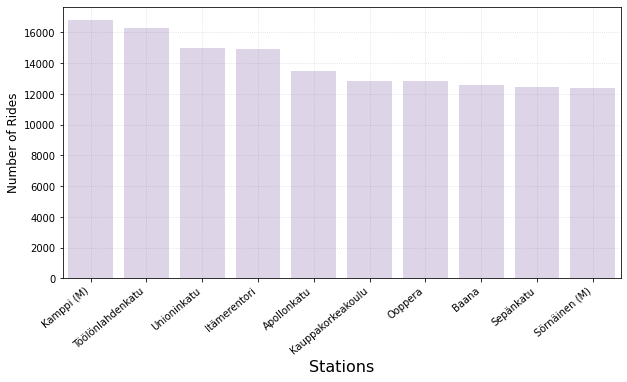

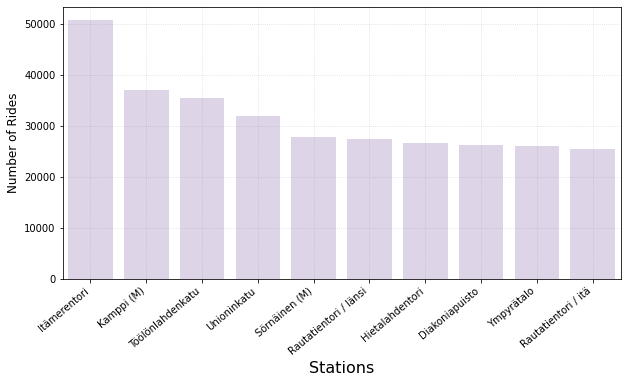

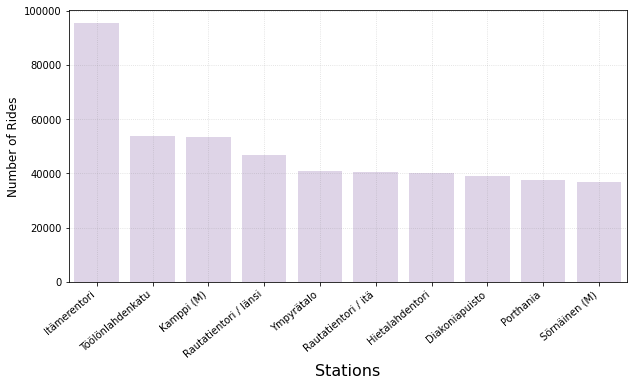

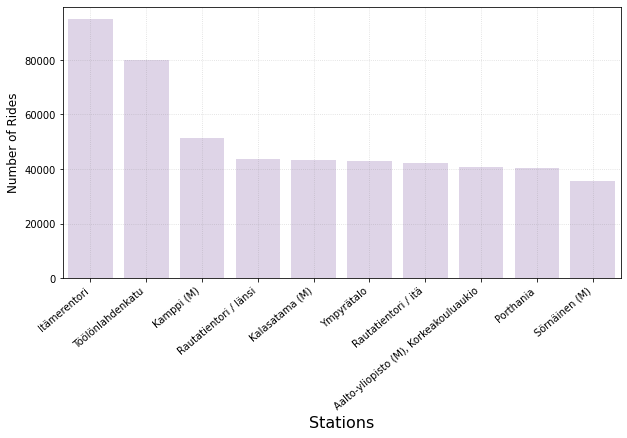

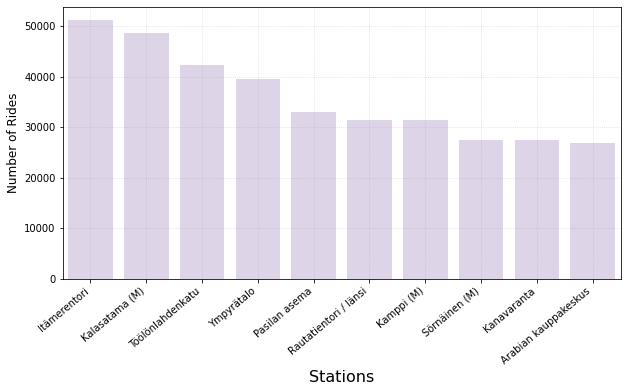

In [16]:
# Top departure station
def topDepartureStations(dataframe,year):
    """
    """
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]

    # Figure
    fig = plt.figure(figsize=(10,5))
    ax = sns.countplot(x="departure_name", color = 'tab:purple',alpha=0.3, data=df, order = df['departure_name'].value_counts().iloc[:10].index)

    # Labeling Axes
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    plt.xlabel("Stations", fontsize= 16, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 12)
    # plt.xlim(-1,20.5)

    # Adding Grid
    plt.grid(linestyle=":", color='grey',alpha=0.3)

for i in range(5):
    topDepartureStations(data_list[i],y[i])

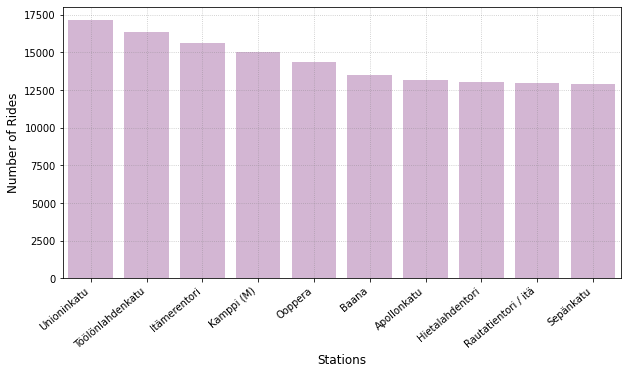

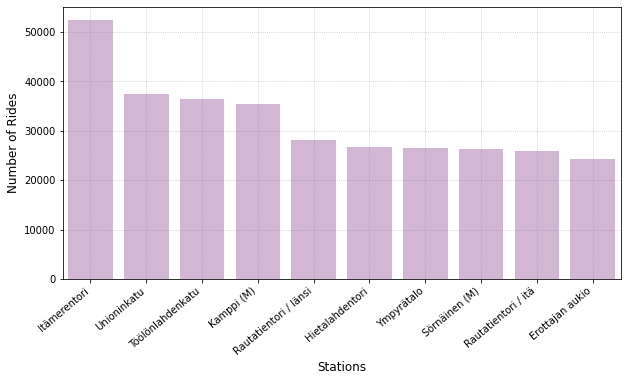

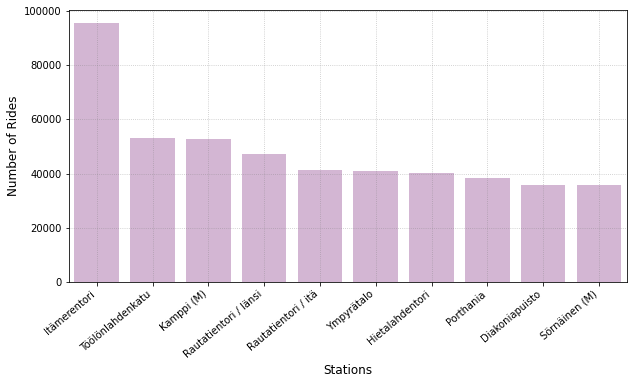

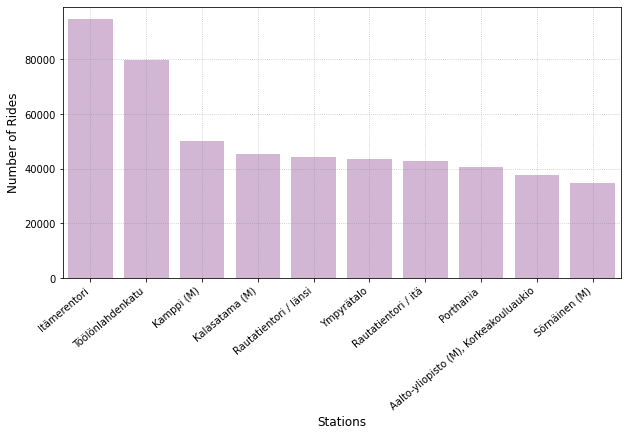

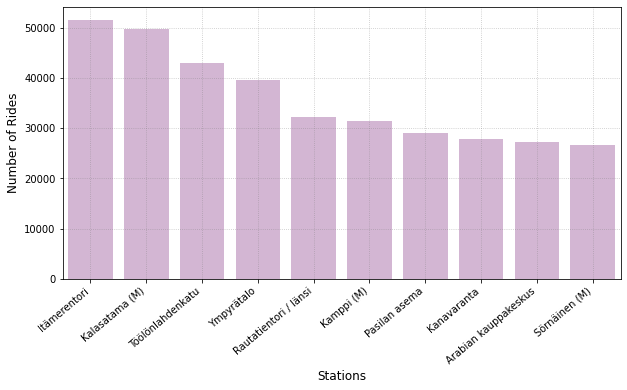

In [17]:
# Top return stations
def topReturnStations(dataframe,year):

    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]

    # Figure
    fig = plt.figure(figsize=(10,5))
    ax = sns.countplot(x="return_name", color = 'purple',alpha=0.3, data=df, order = df['return_name'].value_counts().iloc[:10].index)

    # Labeling Axes
    ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    plt.xlabel("Stations", fontsize= 12, x = 0.5)
    plt.ylabel("Number of Rides", fontsize= 12)
    # plt.xlim(-1,20.5)

    # Adding Grid
    plt.grid(linestyle=":", color='grey', alpha=0.5)

for i in range(5):
    topReturnStations(data_list[i],y[i])

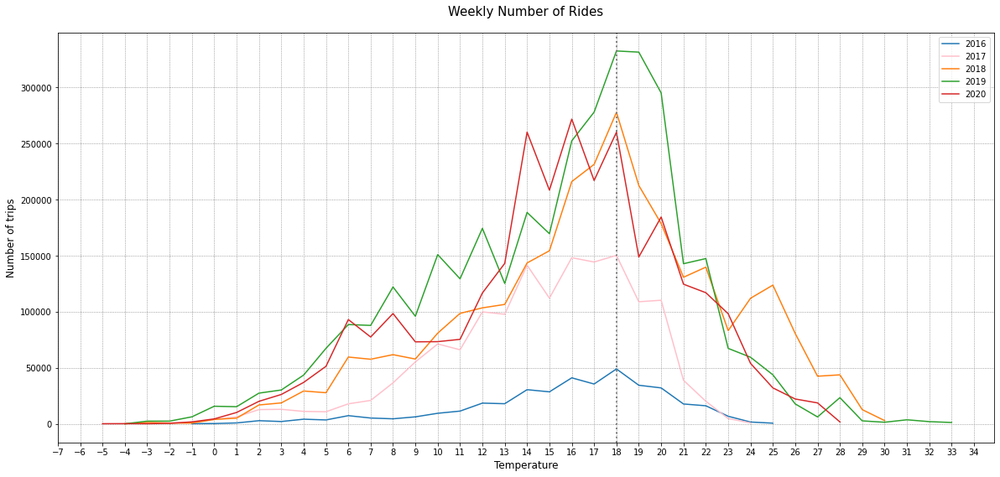

In [18]:
def tripsByTemperature(dataframe):
    
    # Data 
    df = dataframe.copy()
    df['temperature'] = df['temperature'].round(0)
    
    # warnings.simplefilter(action='ignore', category=FutureWarning)
    df_2016 = df[df['departure'].dt.year == 2016]
    df_2017 = df[df['departure'].dt.year == 2017]
    df_2018 = df[df['departure'].dt.year == 2018]
    df_2019 = df[df['departure'].dt.year == 2019]
    df_2020 = df[df['departure'].dt.year == 2020]

    #df_over_time = df.groupby(df['departure'].dt.month).size().reset_index(name='count')
    df_2016 = df_2016.groupby(df['temperature']).size().reset_index(name='count')
    df_2017 = df_2017.groupby(df['temperature']).size().reset_index(name='count')
    df_2018 = df_2018.groupby(df['temperature']).size().reset_index(name='count')
    df_2019 = df_2019.groupby(df['temperature']).size().reset_index(name='count')
    df_2020 = df_2020.groupby(df['temperature']).size().reset_index(name='count')

    # Figure
    fig, ax = plt.subplots(figsize=(20,9))
    plt.plot(df_2016["temperature"], df_2016["count"])
    plt.plot(df_2017["temperature"], df_2017["count"], color= 'pink')
    plt.plot(df_2018["temperature"], df_2018["count"])
    plt.plot(df_2019["temperature"], df_2019["count"])
    plt.plot(df_2020["temperature"], df_2020["count"])


    plt.axvline(18, color="grey", linestyle=':', linewidth=2 ) # midsumer

    # Labels
    ax.set_title("Weekly Number of Rides", fontsize= 15, pad= 20)
    ax.set_ylabel("Number of trips", fontsize=12)
    ax.set_xlabel("Temperature", fontsize=12)
    plt.xticks(np.arange(-7, 35, 1.0))

    # Grid & Legend
    plt.grid(linestyle=":", color='grey')
    plt.legend(["2016","2017","2018","2019","2020"])

    plt.show()

# if function call is commented its for performance reasons
tripsByTemperature(dataframe)

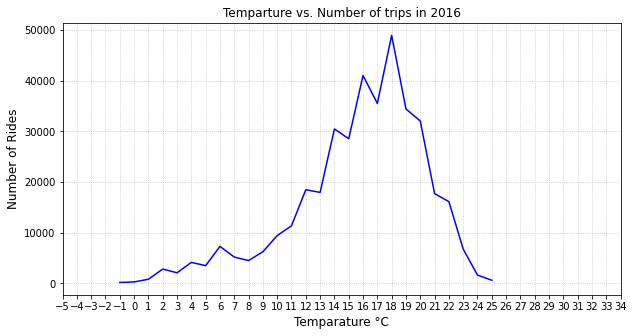

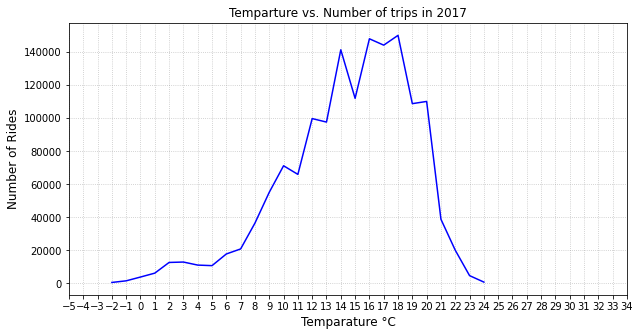

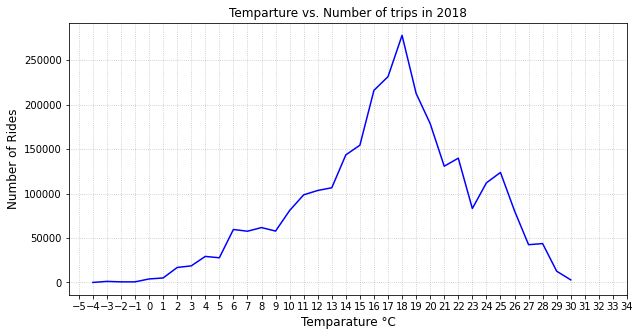

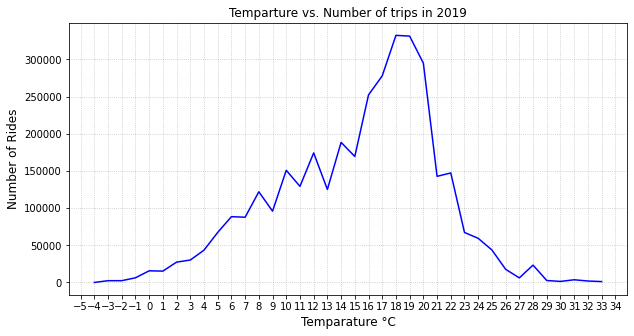

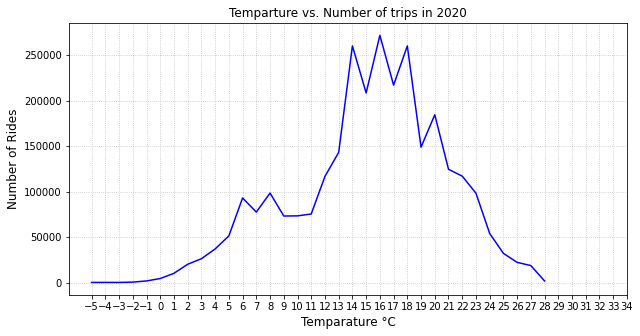

In [19]:
def temperatureLine(dataframe,year,title):

    # Create dataframe
    df = dataframe.groupby(dataframe['temperature'].round(0)).size().reset_index(name='number of trips')
    fig, ax = plt.subplots(figsize=(10,5))
    ax = sns.lineplot(x='temperature',y='number of trips',data=df,color = 'blue')

    # Labels
    ax.set_xlabel("Temparature °C", fontsize= 12, x = 0.5)
    ax.set_ylabel("Number of Rides", fontsize= 12)
    plt.ticklabel_format(style='plain', axis='y')
    plt.xticks(np.arange(-5, 35, 1.0))
    plt.title(title)

    # Grid
    ax.grid(linestyle=":", color='grey',alpha=0.5)


for i in range(5):
    temperatureLine(data_list[i],y[i],'Temparture vs. Number of trips in {}'.format(y[i]))

## Network Analysis

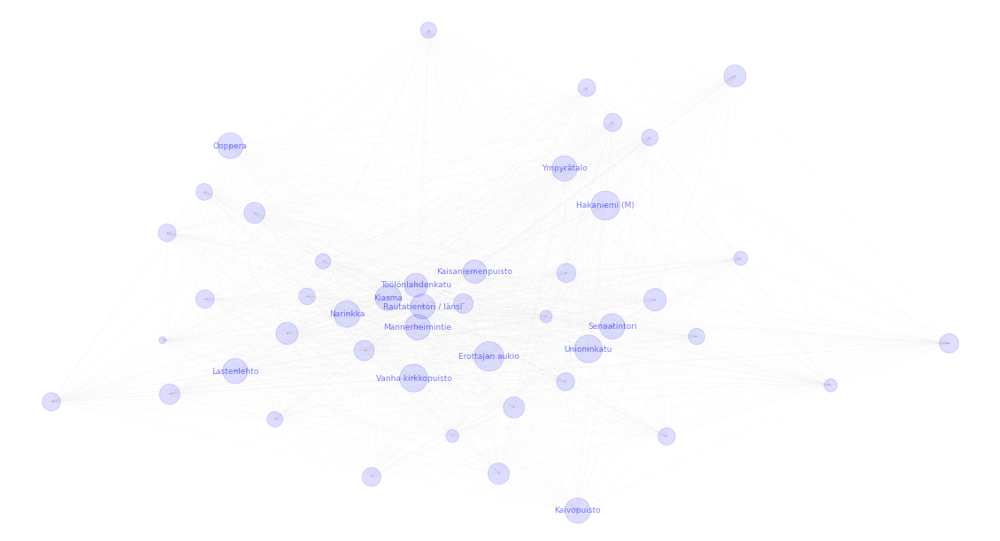

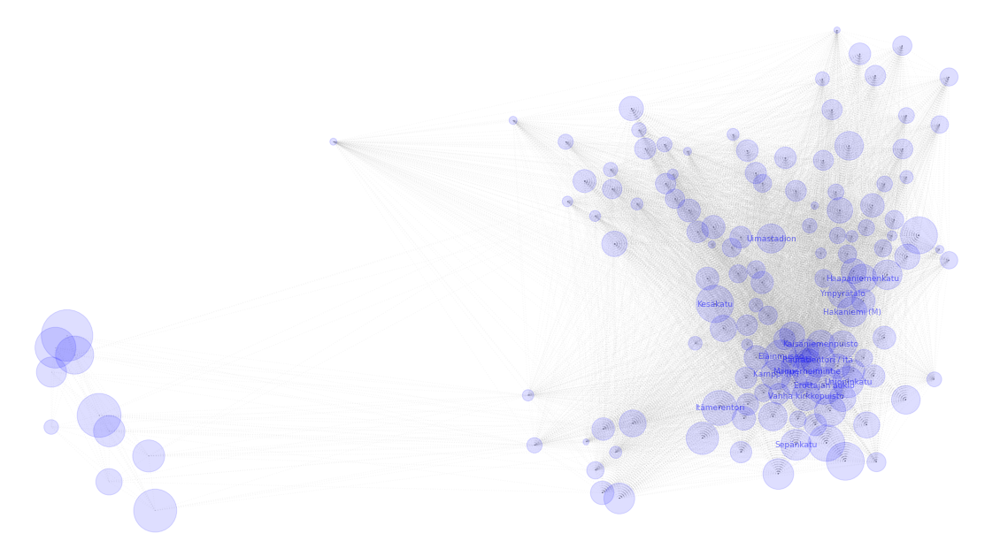

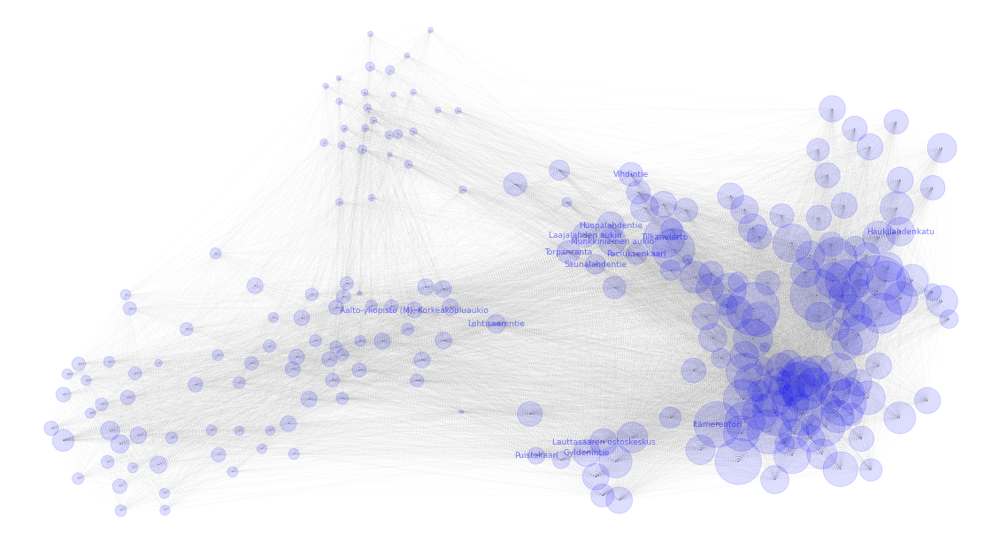

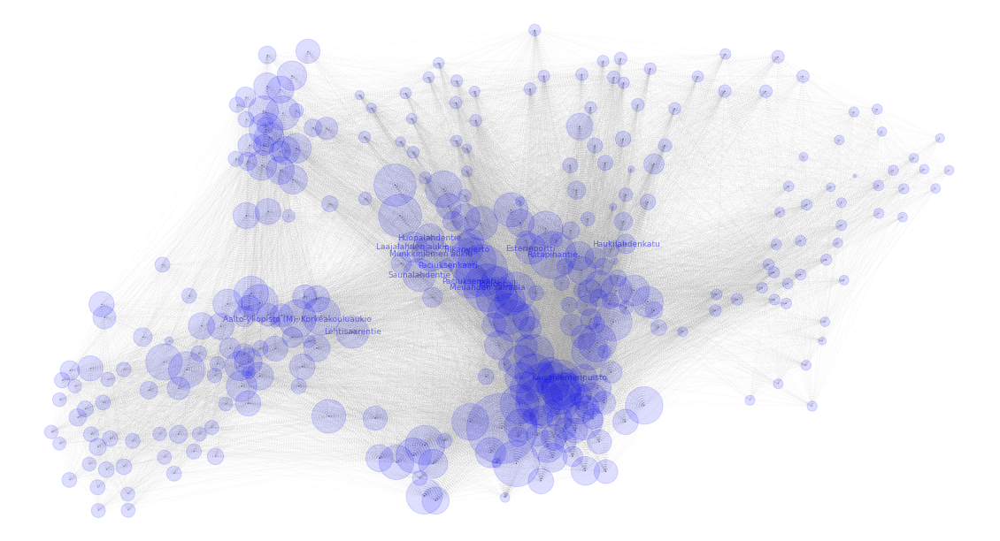

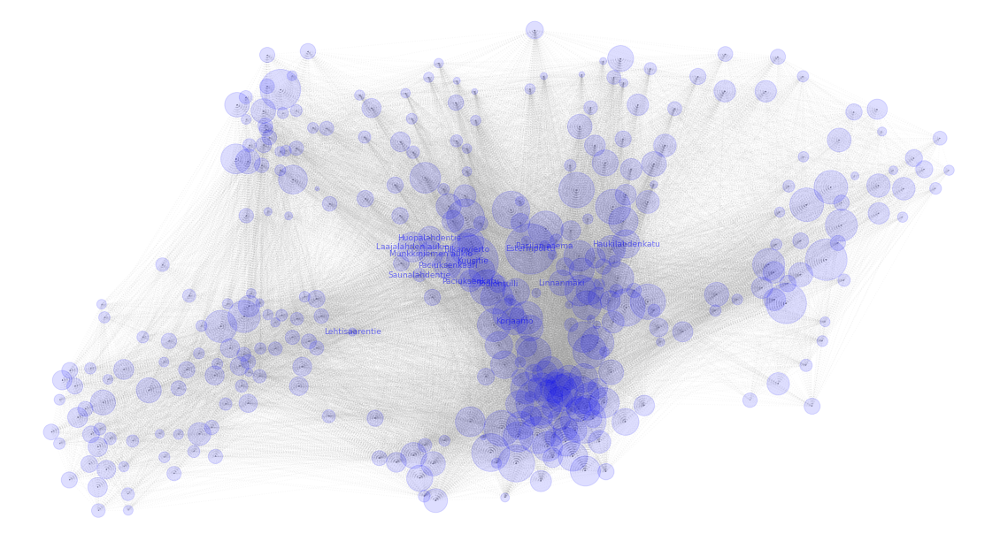

In [13]:
import networkx as nx 
# bike network
def bikeNetwork(dataframe, year):
    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    df.dropna(inplace=True)
    #print(df.isna().sum())
    
    # Graphs
    G = nx.Graph()
    G = nx.from_pandas_edgelist(df, 'departure_name', 'return_name', edge_attr=['duration','distance'])

    degree = dict(nx.degree(G))
    top_5_nodes=dict(sorted(degree.items(), key=lambda x: x[1], reverse=True)[:15])

    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    # Positions
    stations  = pd.read_csv("../station_coordinates.csv")
    stations.set_index('name',inplace=True)
    stations["pos"] = list(zip(stations["longitude"].astype(float), stations["latitude"].astype(float)))
    pos = stations.to_dict()['pos']

    # Map "pos" atribute to nodes from pos dict
    for node, position in pos.items():
        try:
            G.nodes[node]['pos'] = position
        except KeyError:
            pass
    
    top_5_nodes_label = {}
    for node_name in top_5_nodes.keys():
        top_5_nodes_label[node_name] = node_name
    
    # Draw
    nx.draw_networkx_nodes(G=G,pos=G.nodes.data('pos'), node_color='blue', alpha=0.13, node_size= (df['departure_name'].value_counts()/15).tolist())
    nx.draw_networkx_edges(G=G,pos=G.nodes.data('pos'), edge_color='grey', style ="dotted", alpha=0.06, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),labels=top_5_nodes_label,font_size=9,font_color='blue',alpha=0.5)
    ax.axis('off')

    return G


y16 = bikeNetwork(year_2016,2016)
y17 = bikeNetwork(year_2017,2017)
y18 = bikeNetwork(year_2018,2018)
y19 = bikeNetwork(year_2019,2019)
y20 = bikeNetwork(year_2020,2020)

In [17]:
# create a list of network
network_list = [y16,y17,y18,y19,y20]


In [18]:
# summary of network
for i in range(5):
    print(f"year {y[i]: .0f} : {nx.info(network_list[i])}")

year  2016 : Name: 
Type: Graph
Number of nodes: 46
Number of edges: 1081
Average degree:  47.0000
year  2017 : Name: 
Type: Graph
Number of nodes: 142
Number of edges: 8589
Average degree: 120.9718
year  2018 : Name: 
Type: Graph
Number of nodes: 246
Number of edges: 17068
Average degree: 138.7642
year  2019 : Name: 
Type: Graph
Number of nodes: 340
Number of edges: 27708
Average degree: 162.9882
year  2020 : Name: 
Type: Graph
Number of nodes: 347
Number of edges: 29604
Average degree: 170.6282


In [23]:
trips = dataframe.groupby(['year'])['departure'].size()
trips

year
2016     387896
2017    1504845
2018    2915405
2019    3550260
2020    2920444
Freq: A-DEC, Name: departure, dtype: int64

## Basic Network Metrics

In [24]:
from operator import itemgetter

def network_stats(G,year):
    
    degree_dict = dict(G.degree(G.nodes()))
    nx.set_node_attributes(G, degree_dict, 'degree')

    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    print(f"\nTop 5 nodes by degree in {year}:\n")
    for d in sorted_degree[:5]:
        print(d)

    betweenness_dict = nx.betweenness_centrality(G) # Compute betweenness centrality
    eigenvector_dict = nx.eigenvector_centrality(G) # Compute eigenvector centrality

    sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

    print(f"\nTop 5 nodes by betweenness centrality in {year}:\n")
    for b in sorted_betweenness[:5]:
        print(b)

for i in range(5):
    network_stats(network_list[i],y[i])


Top 5 nodes by degree in 2016:

('Erottajan aukio', 47)
('Hakaniemi (M)', 47)
('Unioninkatu', 47)
('Vanha kirkkopuisto', 47)
('Narinkka', 47)

Top 5 nodes by betweenness centrality in 2016:

('Erottajan aukio', 0.0)
('Hakaniemi (M)', 0.0)
('Unioninkatu', 0.0)
('Vanha kirkkopuisto', 0.0)
('Narinkka', 0.0)

Top 5 nodes by degree in 2017:

('Itämerentori', 135)
('Kesäkatu', 133)
('Erottajan aukio', 133)
('Rautatientori / itä', 133)
('Eläinmuseo', 133)

Top 5 nodes by betweenness centrality in 2017:

('Puistokaari', 0.02974991210915593)
('Luoteisväylä', 0.027161382684509926)
('Lauttasaaren ostoskeskus', 0.024193885660784842)
('Gyldenintie', 0.009544309300237575)
('Heikkiläntie', 0.008131800973744935)

Top 5 nodes by degree in 2018:

('Haukilahdenkatu', 215)
('Lauttasaaren ostoskeskus', 212)
('Laajalahden aukio', 212)
('Lehtisaarentie', 212)
('Munkkiniemen aukio', 207)

Top 5 nodes by betweenness centrality in 2018:

('Haukilahdenkatu', 0.012110178594159908)
('Aalto-yliopisto (M), Korkeako

In [25]:
import folium 
def mapPlot(dataframe, year):

    # Data
    df = dataframe.copy()
    df = df[df['departure'].dt.year == year]
    #df = df[:1000]
    df.dropna(inplace=True)
    df['freq'] = df.groupby('departure_name')['departure_name'].transform('count')
    #print(df.isna().sum())
    df["name"] = df["departure_name"]
    df = df[["name", "freq"]]
    df = df.drop_duplicates(subset=['name'])
    freq_dict = dict(zip(df.name, df.freq))

    df_stations = pd.read_csv("data/downloaded_data/station_coordinates.csv")
    df_stations['freq']= df_stations['name'].map(freq_dict)
    df_stations["freq_adj"] = df_stations['freq']/(df_stations['freq'].mean()/3)
    df_stations.dropna(inplace=True)

    # Map
    hel_map = folium.Map([60.1975594, 24.9320720], zoom_start=12)
    folium.TileLayer('Stamen Terrain').add_to(hel_map)

    for index, row in df_stations.iterrows():
        folium.CircleMarker([row['latitude'],row['longitude']],
                        radius=row["freq_adj"],
                        popup=[row['name'],row['freq']],
                        color="#060606",
                        fill_color="#060606",
                    ).add_to(hel_map)
        points = []
        points.append(tuple([row['latitude'],row['longitude']]))
        folium.PolyLine(points, color="black", weight=5, opacity=1).add_to(hel_map)
    display(hel_map)
    
# function call is commented for performance reasons
for i in range(5):
    mapPlot(data_list[i],y[i])



# Degree Centrality


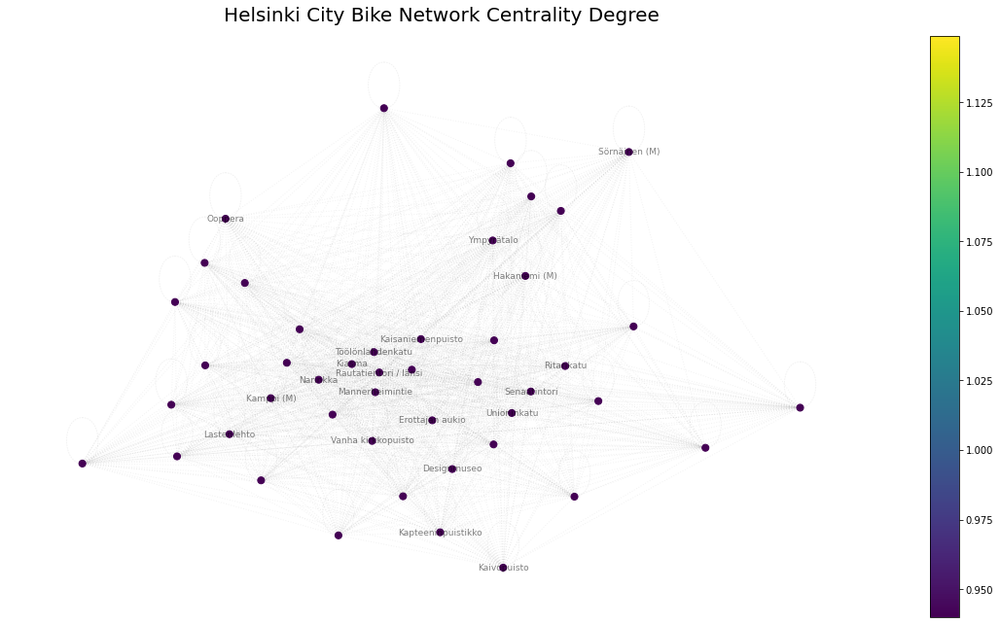

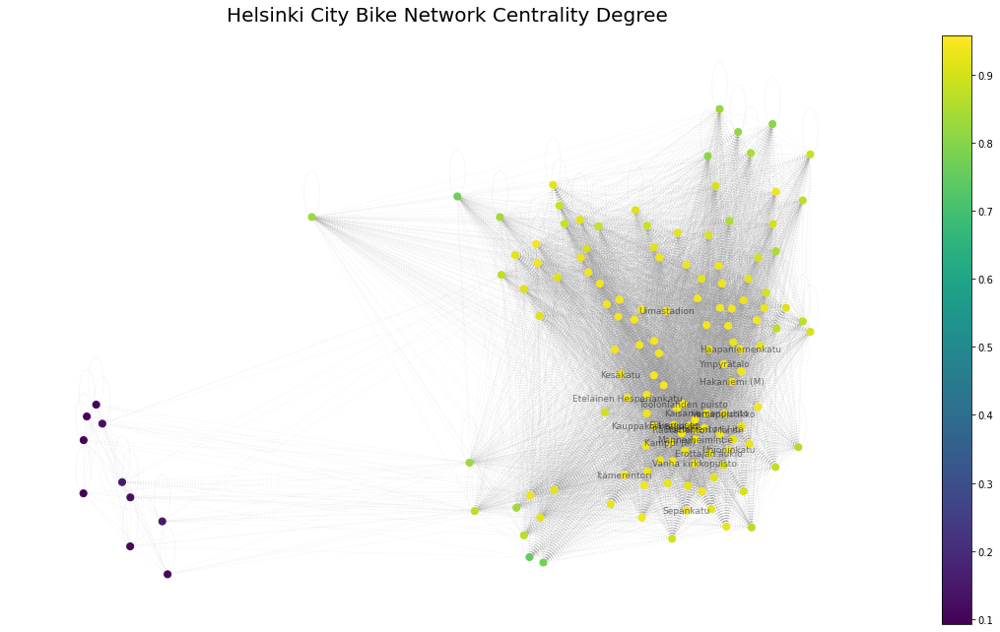

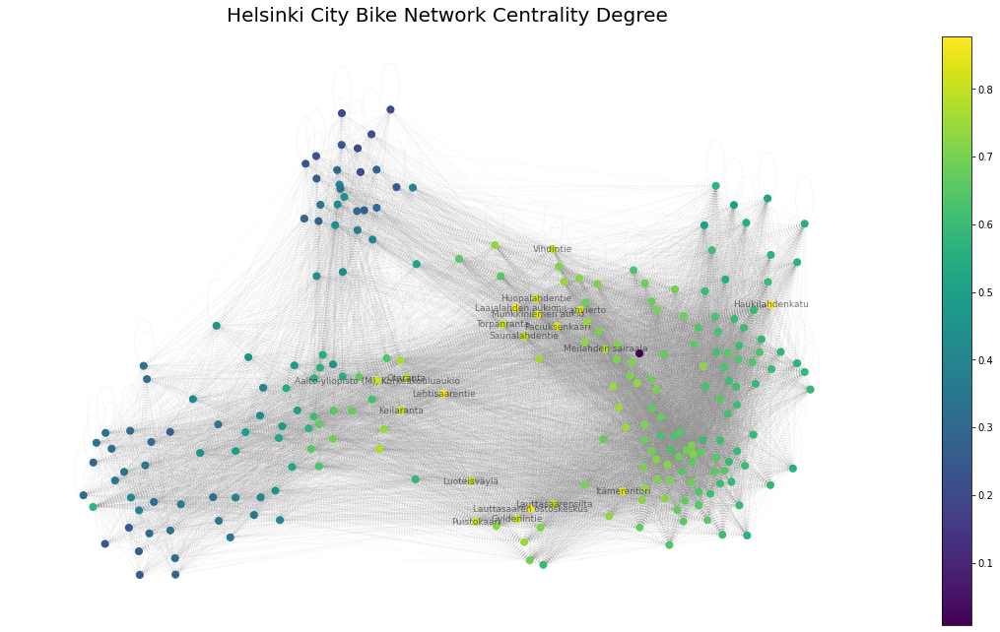

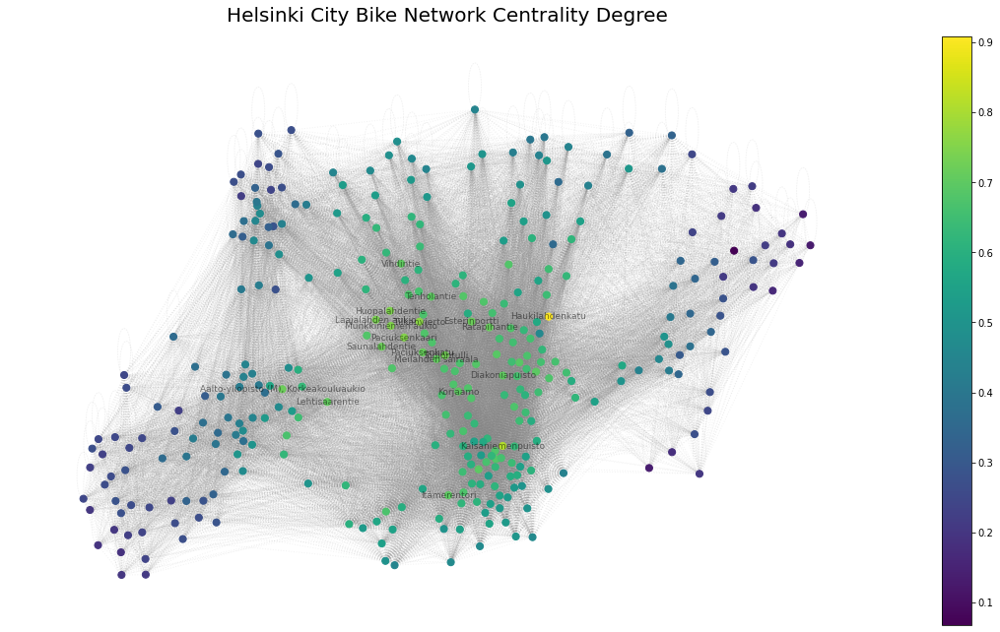

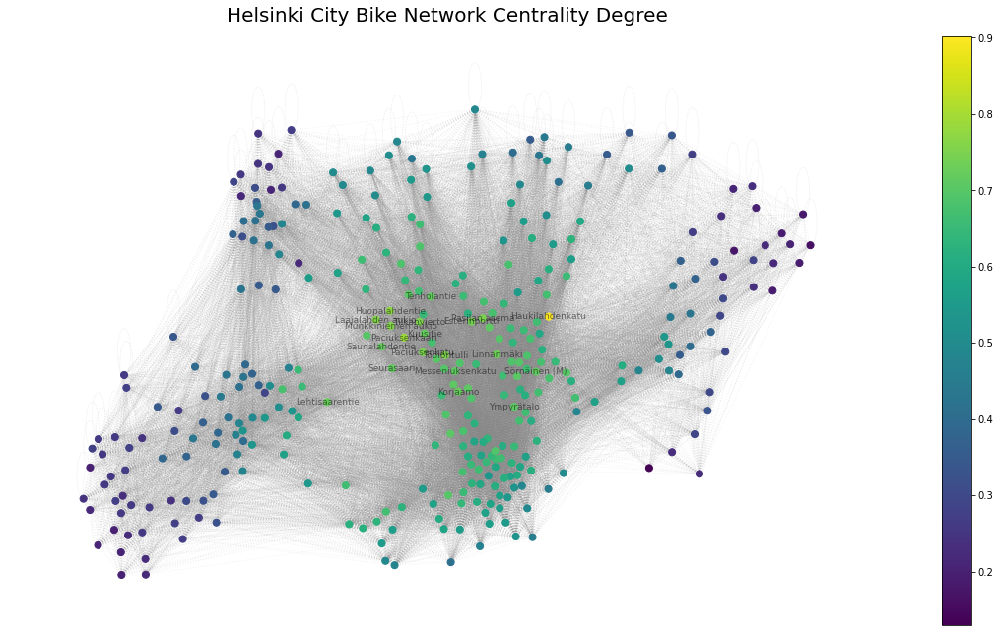

In [26]:
def centralityDegree(G):

    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    degree = nx.degree_centrality(G)
    node_color = [degree[i] for i in degree.keys()]
    
    top_5_nodes=dict(sorted(degree.items(), key=lambda x: x[1], reverse=True)[:20])
    

    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)
    
    top_5_nodes_label={}
    for node_name in top_5_nodes.keys():
        top_5_nodes_label[node_name]=node_name

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos'),node_color=node_color,cmap="viridis", alpha=1, node_size=50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos'),edge_color='grey',style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),labels=top_5_nodes_label,font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Centrality Degree', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

# function call is commented for performance reasons
for i in network_list[:5]:
    centralityDegree(i)



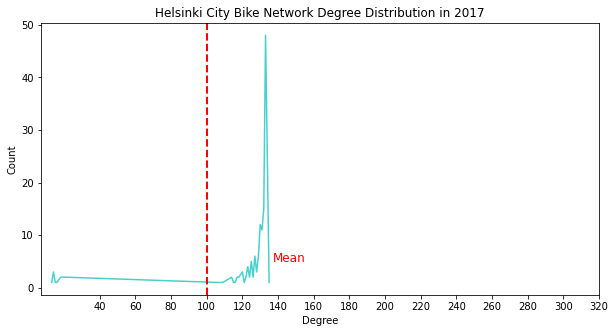

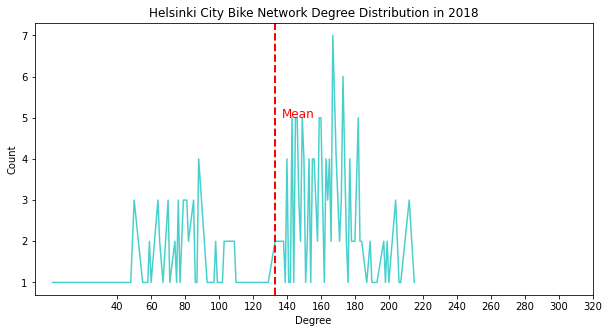

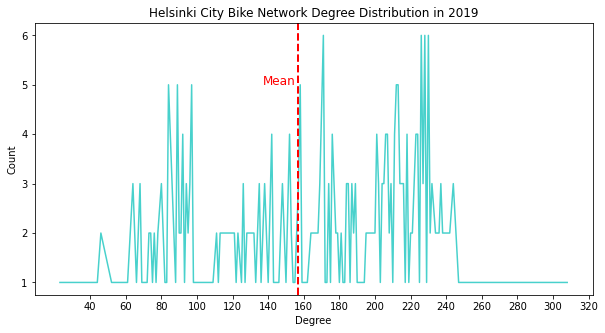

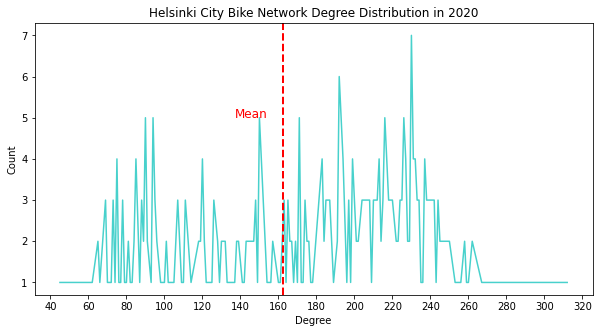

In [27]:
import collections

def centralityDegreeDist(G,title):

    # Degree
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())

    # Figure
    fig, ax = plt.subplots(figsize=(10,5))
    plt.plot(deg, cnt, color='mediumturquoise')
    plt.axvline(x = sum(deg)/len(deg), color='r', linestyle='--', linewidth=2) # Degree Mean
    #plt.axvline(x = np.median(deg), color="blue", linestyle='-', linewidth=1) # Degree Median

    # Labeling
    plt.title(title)
    plt.ylabel("Count")
    plt.xlabel("Degree")
    plt.text(x=137,y=5, s="Mean", color = 'r', fontsize= 12)
    ax.set_xticks(range(40,340,20))

    plt.show()
    
for i in range(1,5):
    centralityDegreeDist(network_list[i],'Helsinki City Bike Network Degree Distribution in {}'.format(y[i]))


# Betweenness Centrality


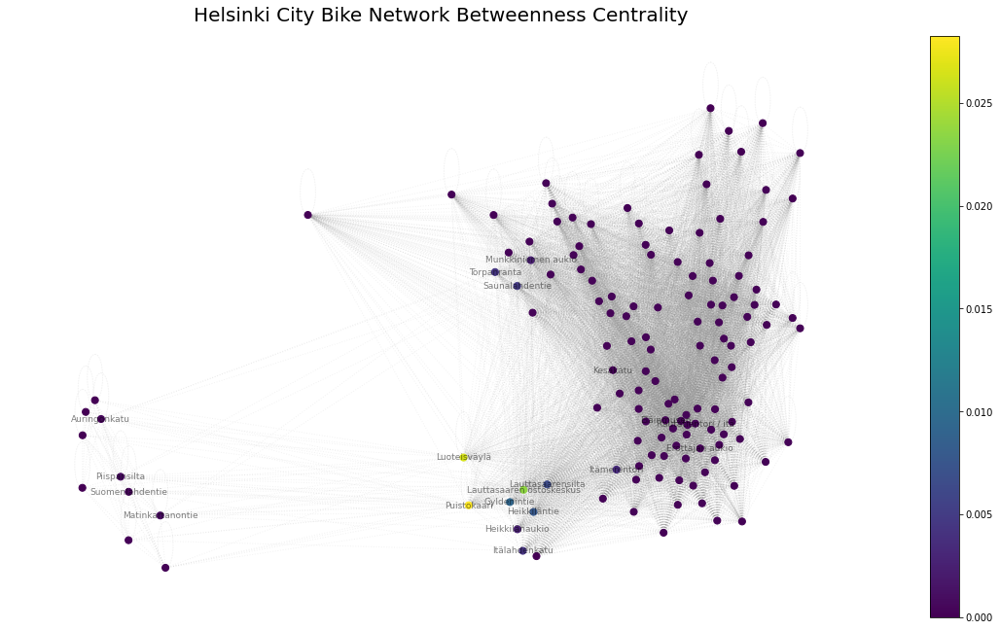

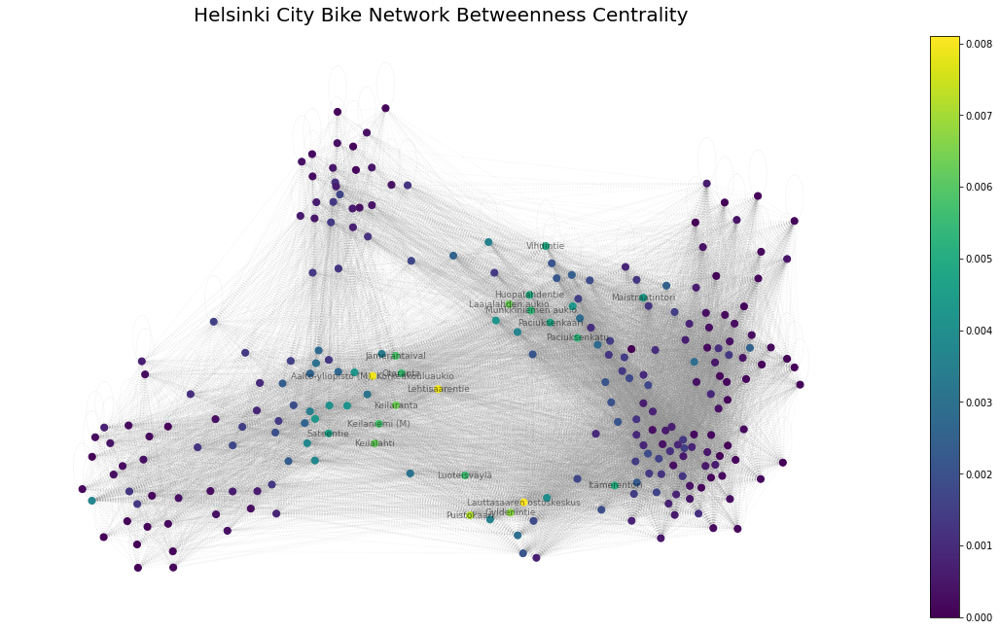

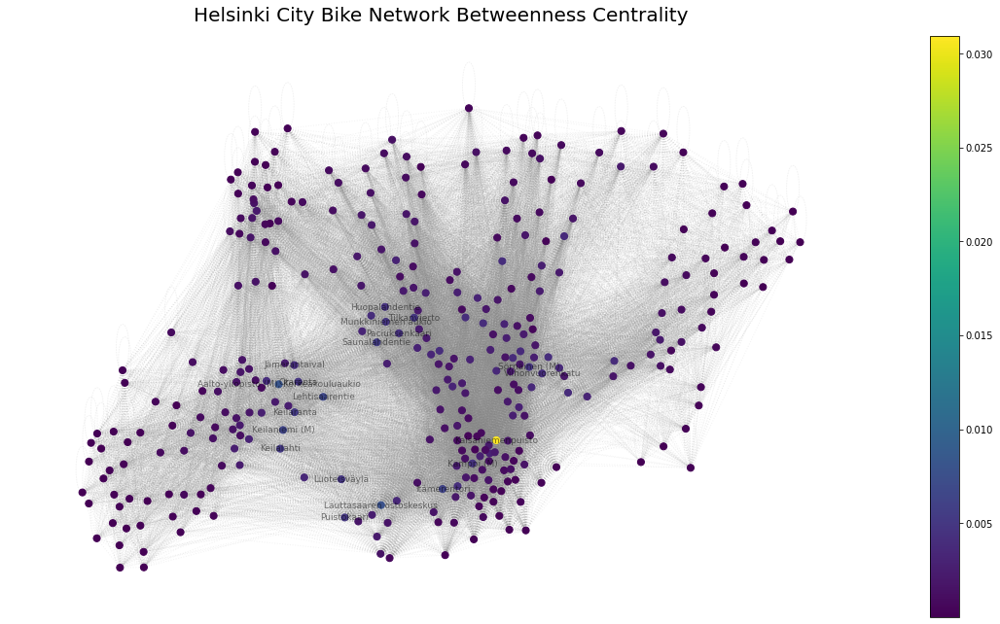

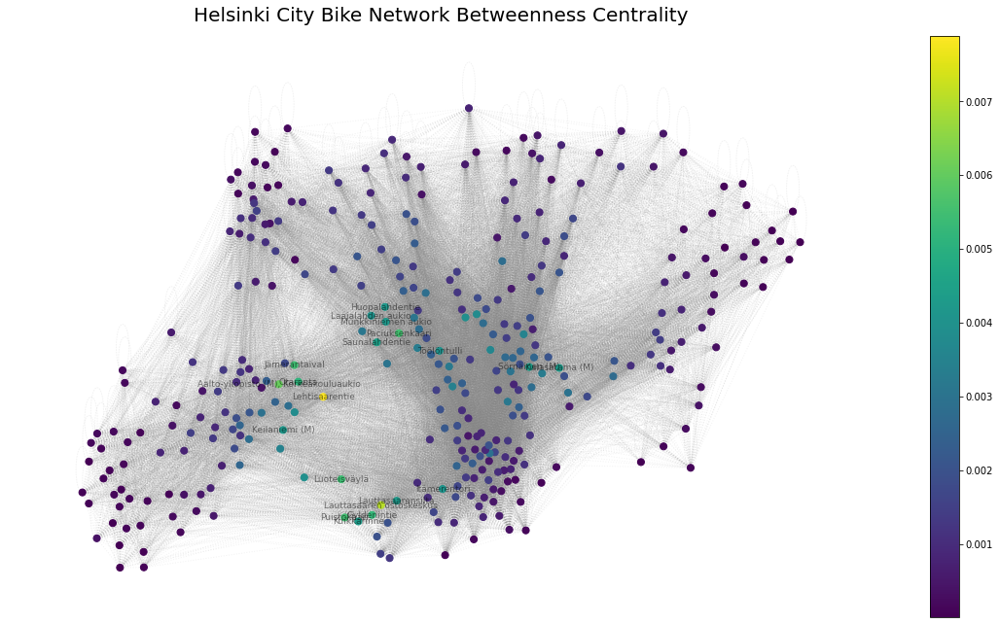

In [28]:
def centralityBetweenness(Graph): 
    
    G = Graph.copy(as_view=False)
    G.remove_node("Haukilahdenkatu")
        
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    betweenness = nx.betweenness_centrality(G)
    
    top_5_nodes=dict(sorted(betweenness.items(), key=lambda x: x[1], reverse=True)[:20])
    
    node_color = [betweenness[i] for i in betweenness.keys()]

    # Color scale
    colors=range(20,40)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color) - (sum(node_color)/len(node_color))
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)

    top_5_nodes_label={}
    for node_name in top_5_nodes.keys():
        top_5_nodes_label[node_name]=node_name
    #print(li)
    
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=1, node_size= 50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),labels=top_5_nodes_label, font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Betweenness Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

for i in network_list[1:]:
    centralityBetweenness(i)

# Closeness Centrality


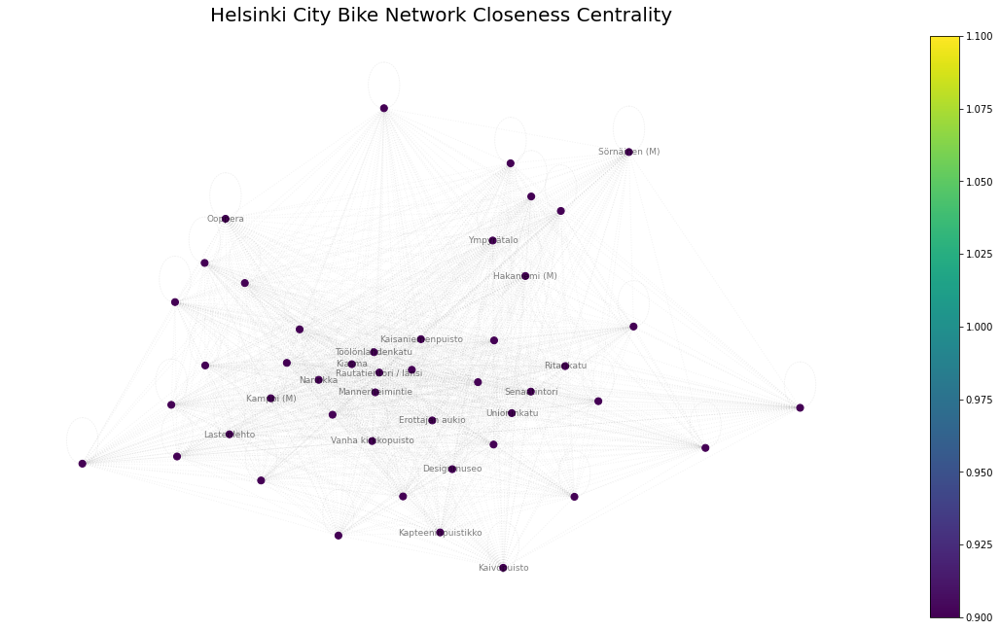

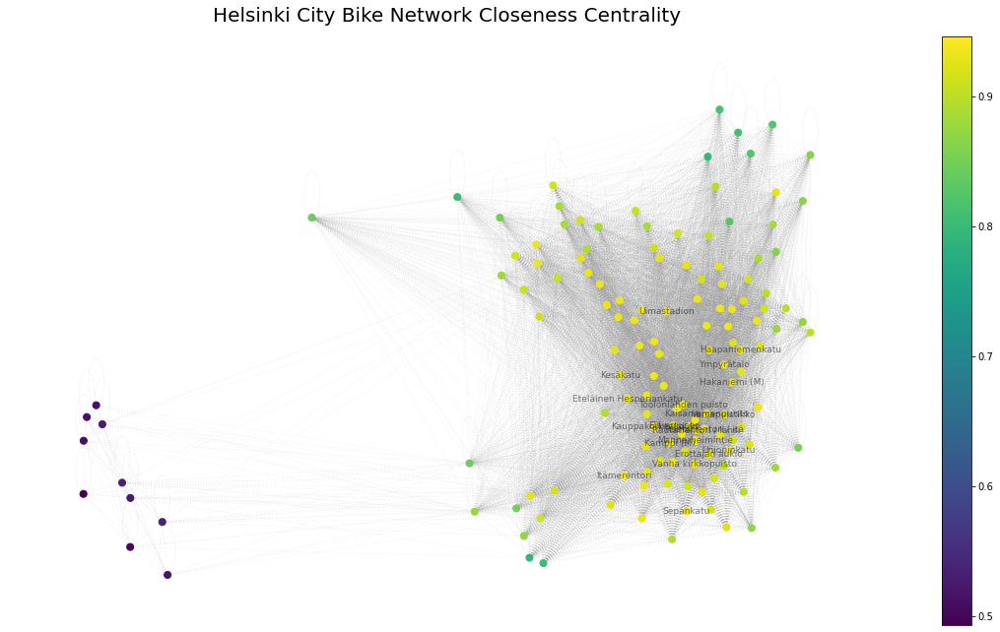

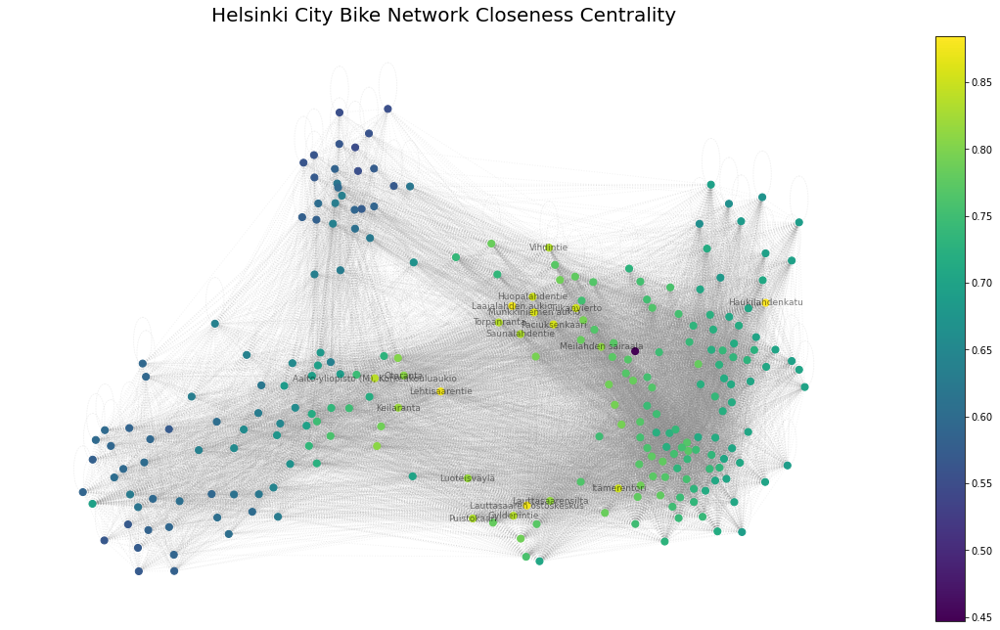

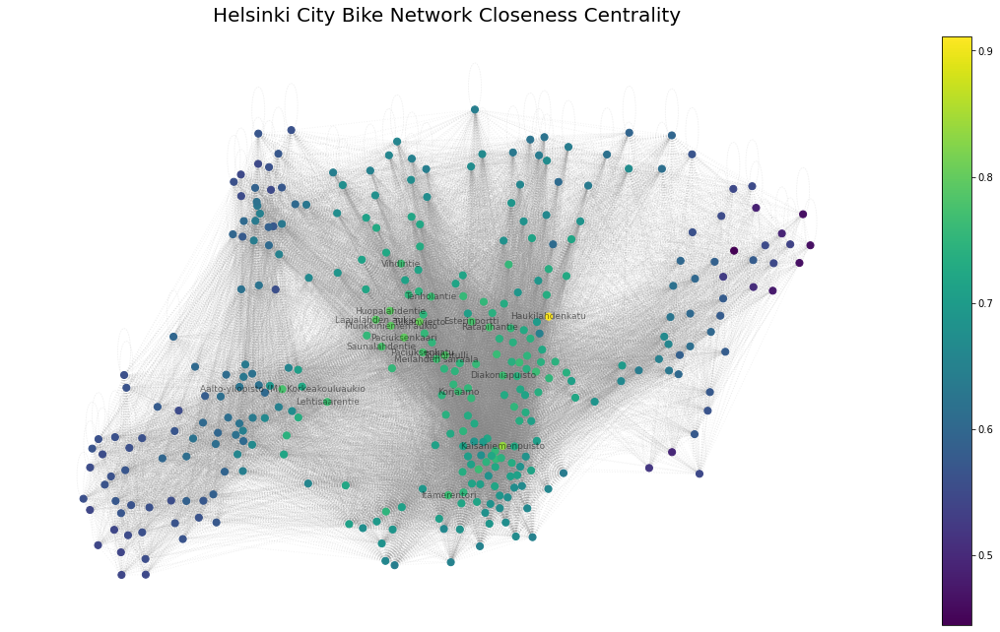

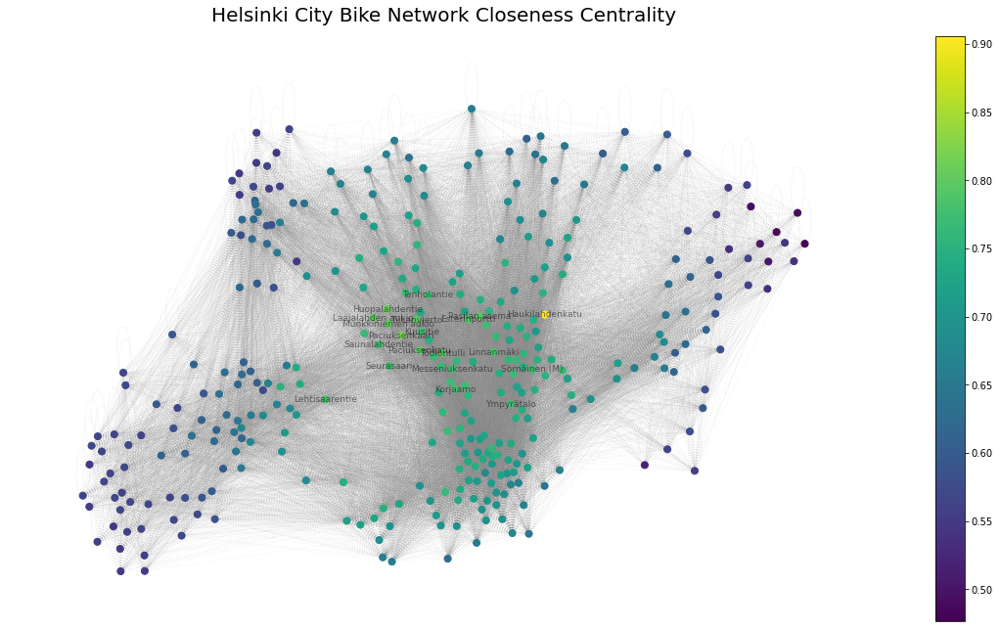

In [29]:
def centralityCloseness(G):

    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    closeness = nx.closeness_centrality(G)
    node_color = [closeness[i] for i in closeness.keys()]
    
    top_5_nodes=dict(sorted(closeness.items(), key=lambda x: x[1], reverse=True)[:20])
    
    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)
    
    top_5_nodes_label={}
    for node_name in top_5_nodes.keys():
        top_5_nodes_label[node_name]=node_name

    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=1, node_size= 50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),labels=top_5_nodes_label,font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Closeness Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')

for i in network_list:
    centralityCloseness(i)

# Eigenvector centrality


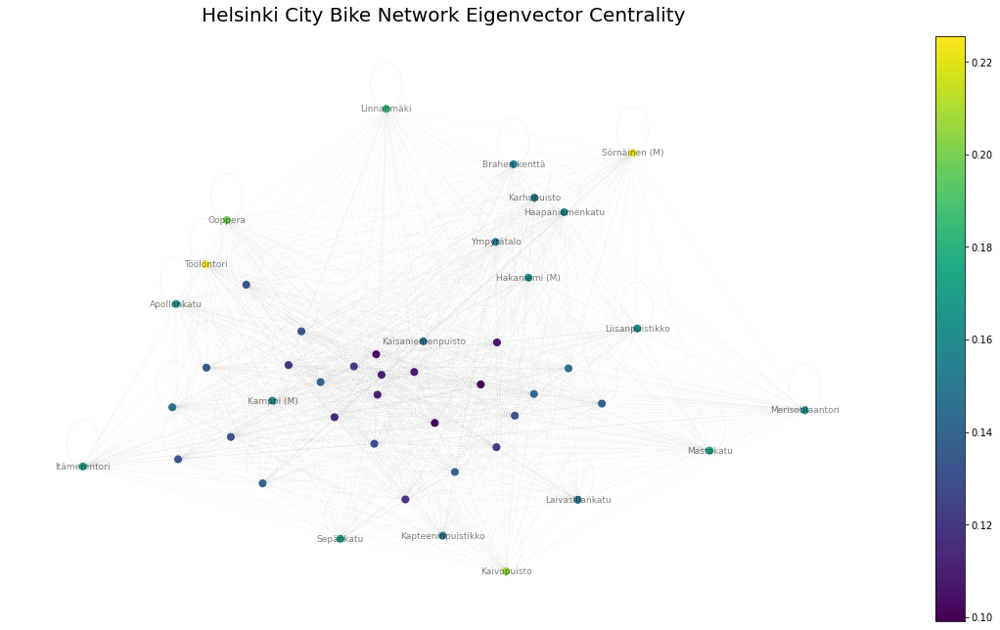

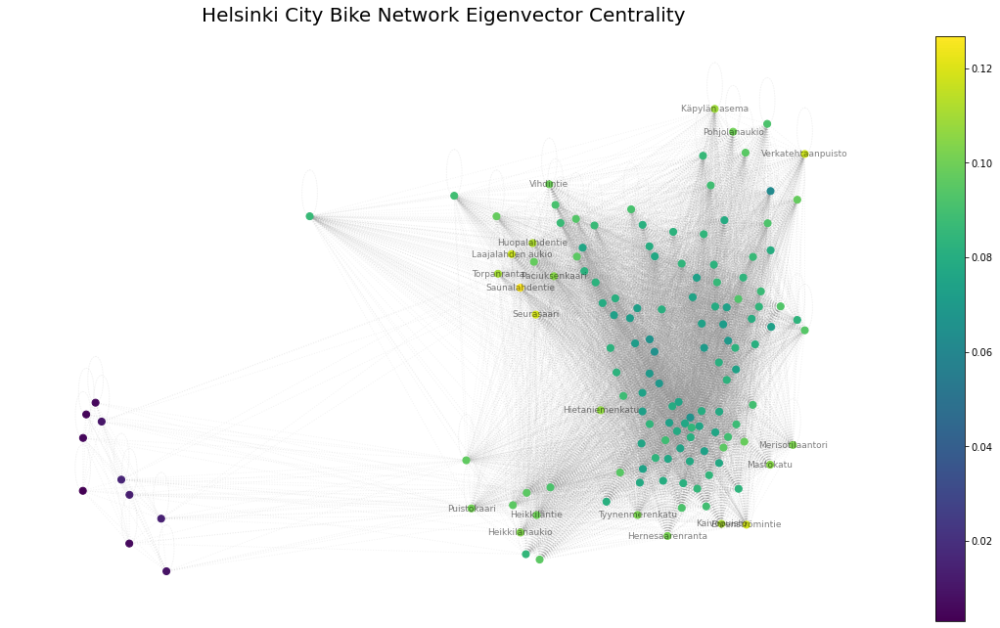

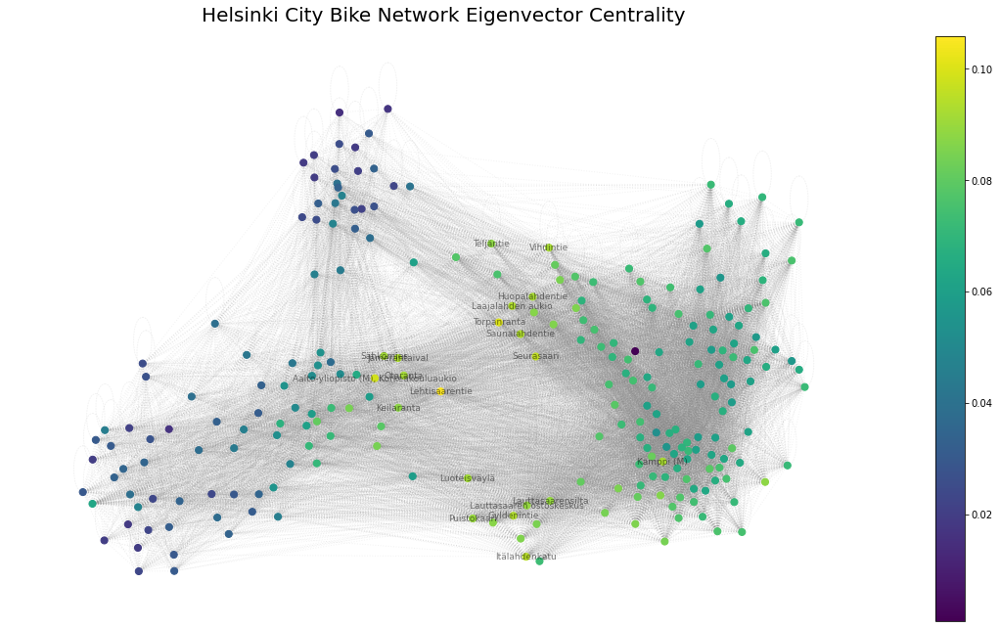

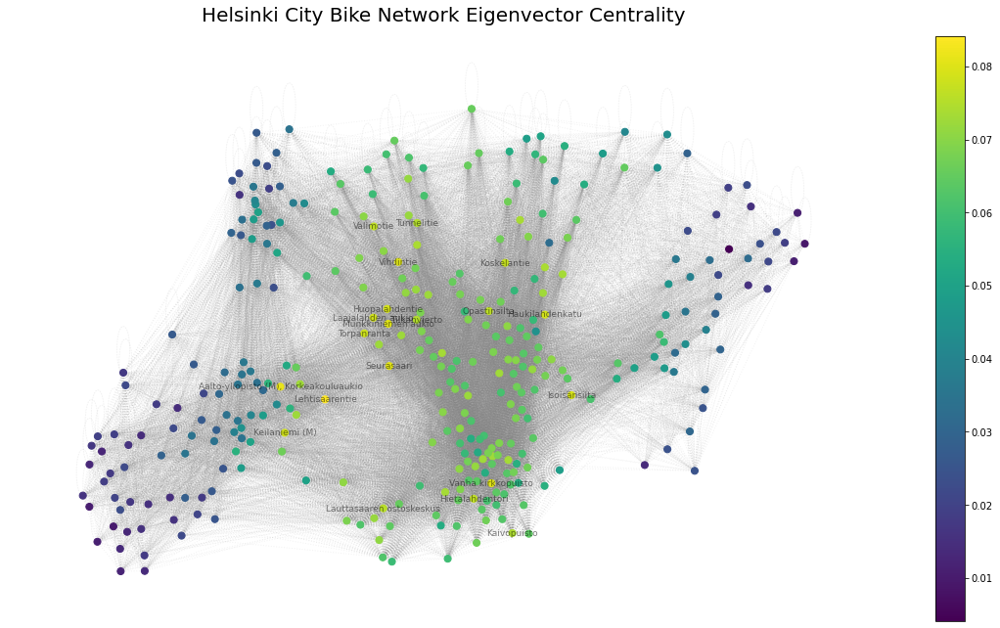

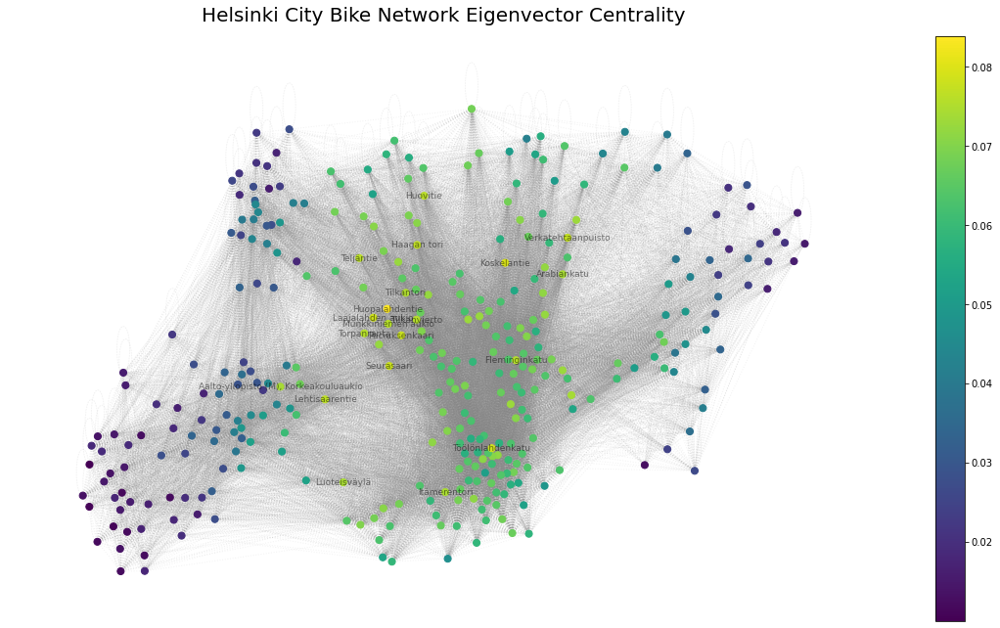

In [30]:
def centralityEigenvector(G):

    # Figure
    fig, ax = plt.subplots(figsize=(20,11))

    eigenvector = nx.eigenvector_centrality(G, max_iter=6000, weight="duration")
    node_color = [eigenvector[i] for i in eigenvector.keys()]
    
    top_5_nodes=dict(sorted(eigenvector.items(), key=lambda x: x[1], reverse=True)[:20])

    # Color scale
    colors=range(20)
    cmap=plt.cm.viridis
    vmin = min(node_color)
    vmax = max(node_color)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = vmin, vmax=vmax))
    sm._A = []
    plt.colorbar(sm)
    
    top_5_nodes_label={}
    for node_name in top_5_nodes.keys():
        top_5_nodes_label[node_name]=node_name
        
    # Draw
    nx.draw_networkx_nodes(G=G, pos=G.nodes.data('pos') ,node_color=node_color,cmap="viridis", alpha=1, node_size= 50)
    nx.draw_networkx_edges(G=G, pos=G.nodes.data('pos') ,edge_color='grey', style ="dotted", alpha=0.1, arrows=False)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),labels=top_5_nodes_label,font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title('Helsinki City Bike Network Eigenvector Centrality', fontdict={"fontsize":20}, pad = 15)
    ax.axis('off')


# function call is commented for performance reasons
for i in network_list:
    centralityEigenvector(i)

## Fluid Communities Method


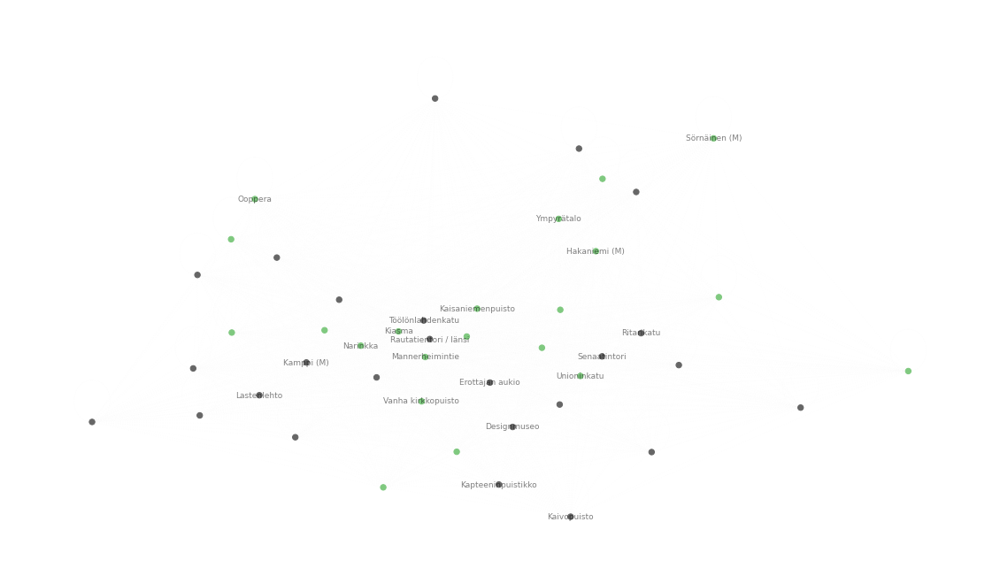

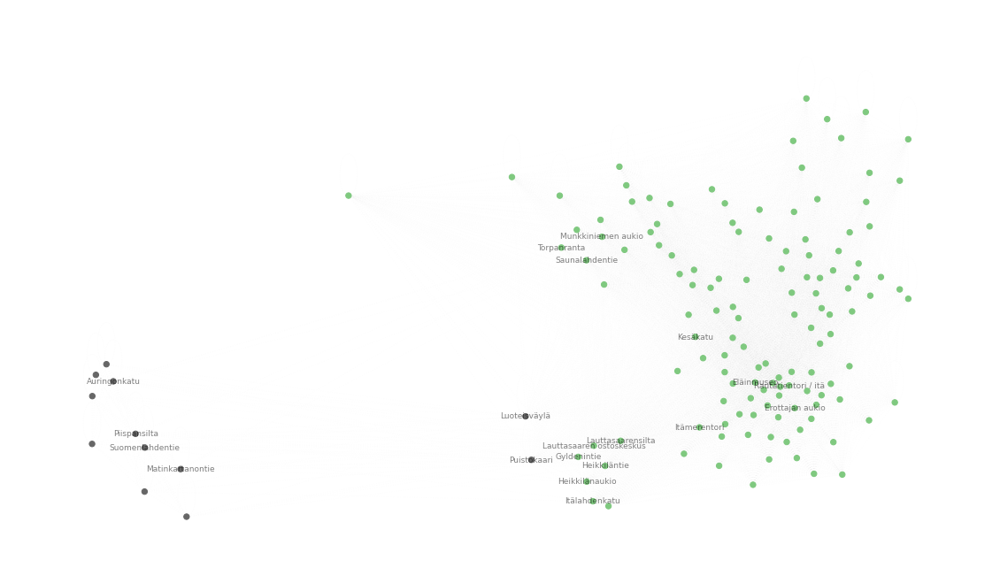

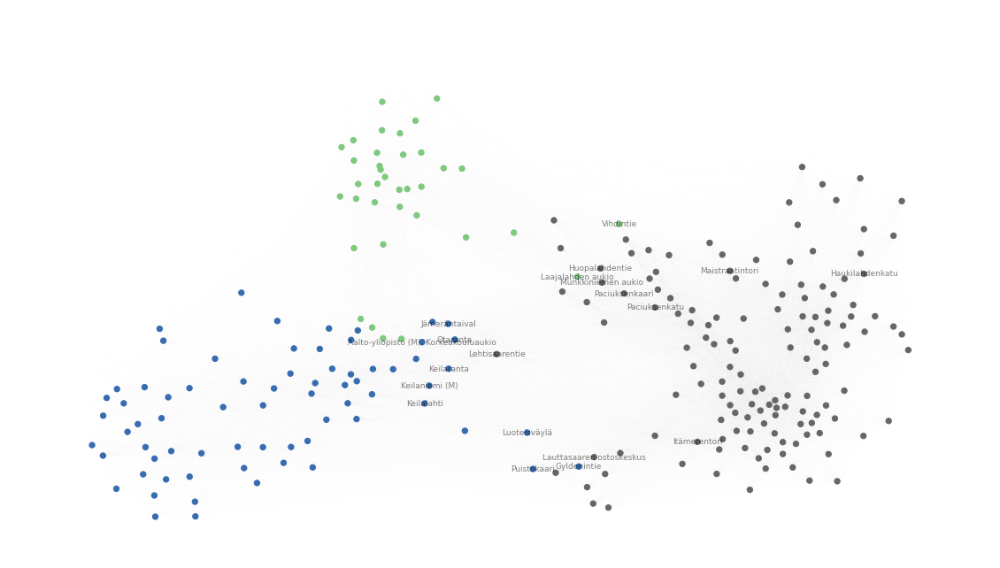

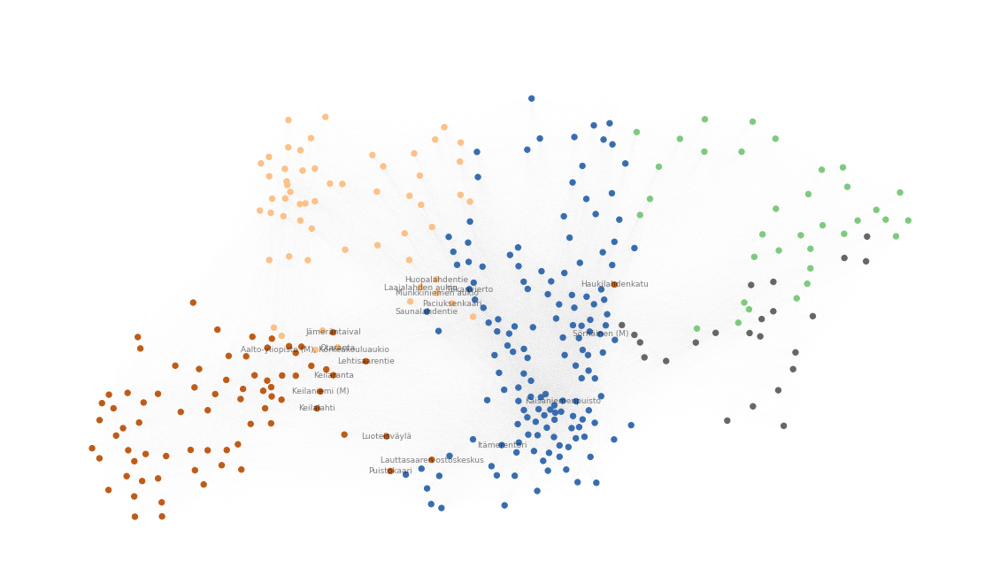

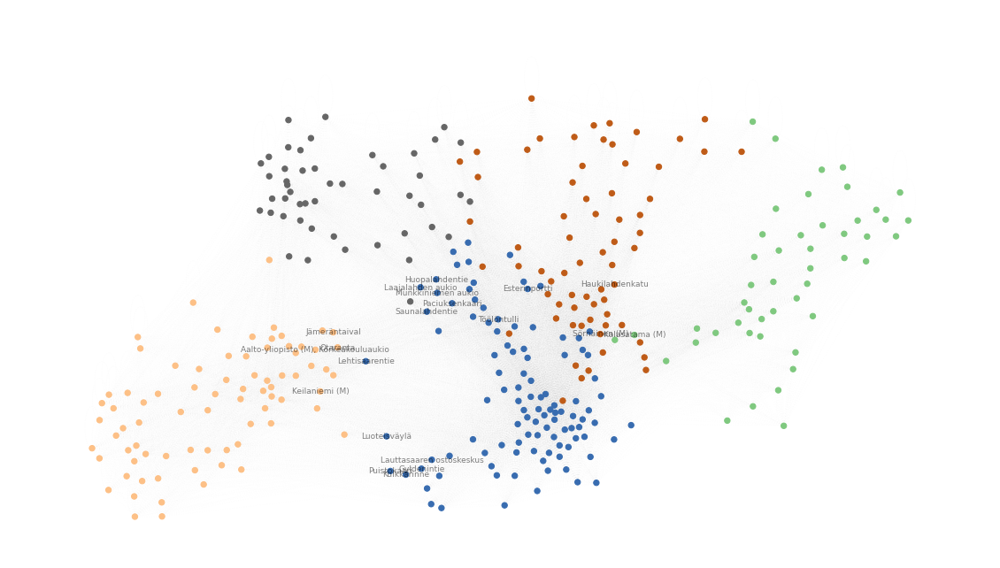

In [31]:
def communityFluid(G,k,title):
    
    # Figure
    fig, ax = plt.subplots(figsize=(20,11))
    betweenness = nx.betweenness_centrality(G)
    node_color = [betweenness[i] for i in betweenness.keys()]
    top_5_nodes=dict(sorted(betweenness.items(), key=lambda x: x[1], reverse=True)[:20])

    # Compute Fluid method
    communities = nx.algorithms.community.asyn_fluid.asyn_fluidc(G, k=k, max_iter=10000, seed=1)
    
    # Assigning each node to its cluster
    partition = {}
    for idx, val in enumerate(communities):
        for k in val:
            partition[k] = idx

    # Partition colormap
    cmap = cm.get_cmap('Accent', max(partition.values()) + 1)

    top_5_nodes_label={}
    for node_name in top_5_nodes.keys():
        top_5_nodes_label[node_name]=node_name

    # Draw Nodes & Edges
    nx.draw_networkx_nodes(G, G.nodes.data('pos'), partition.keys(), node_size=40, cmap=cmap, node_color=list(partition.values()))
    nx.draw_networkx_edges(G, G.nodes.data('pos'), edge_color='grey',style ="dotted", alpha=0.015)
    nx.draw_networkx_labels(G=G, pos=G.nodes.data('pos'),labels=top_5_nodes_label,font_size=9,font_color='k',alpha=0.5)

    # Labeling Axes
    ax.set_title(title, fontdict={"fontsize":20}, pad = 15,color='white')
    ax.axis('off')

    plt.show()
    
# implement algorithm
communityFluid(y16,2,'Helsinki City Bike Network Communities (Fluid Communities) in {}'.format(2016))
communityFluid(y17,2,'Helsinki City Bike Network Communities (Fluid Communities) in {}'.format(2017))
communityFluid(y18,3,'Helsinki City Bike Network Communities (Fluid Communities) in {}'.format(2018))
communityFluid(y19,5,'Helsinki City Bike Network Communities (Fluid Communities) in {}'.format(2019))
communityFluid(y20,5,'Helsinki City Bike Network Communities (Fluid Communities) in {}'.format(2020))



## Modelling

In this part of the notebook we are trying to use the before computed centrality measures to predict the number of trips and thus, the number of bikes that have been used throughout the year 2020, in each node. 

Firstly after creating the dataset with four centrality measurers and number of trips for each node, we verify either if there's multicollinerity between them or not.
What we find is that as we could expect that there is some multicollinearity between the variables besides the Betweenness centrality that is apparentely uncorrelated with the others centrality measurers. 

We decide after some visualization needed to see the type of relationships between indipendent and the dependent variables to deploy a **simple linear model** that at first glance doesn't seem to perform very well with the best value of the $R^2$ = 0.41 with the Closeness Centrality as our X.  <br />
Using the same X variable we use a **Polynomial regression** with a gridsearch to look for the best degree that results being the third, giving us the results of an $R^2$ = 0.51 <br />
Although some collinearity was detected from our VIF formula, we decided to perform a **multiple linear regression** with a K fold cross validation with grid search to detect the best number and combination of features.
The algorithm endend up with the Betweenness and Closeness centrality as being the indipendent variables that resulted a $R^2$ = 0.44

Having only a 0.51 $R^2$ achived by the third polynomial regression, although acnkowledgning our limit given the scaristy of data points with which we needed to train and test our models with, we decided to deploy more complex model that could explain better non linear relationships between our Y and the other variables. 
Starting with a **regression tree** we just obtained an $R^2$ = 0.19. <br/>
Our second try was to deploy a **Support Vector Regression** with a grid search to select the best combination of hyperparameter that ended up being {'C': 5000, 'epsilon': 0.2, 'gamma': 1e-28 } with a linear kernel, that reached a $R^2$ of 35. <br />

Given the low performance of our regression tree compared to the SVM's and the regression's one we implement a  **random forest** with gridsearch in which we used 100 estimators. Eventually the model led us to reach an $R^2$ = 35%. <br />



Our last model was a simple **Neural Network** with 4 dense fully connected layer with ReLu as activation function and the last one having a linear one as our task was to perform a regression. 
The input features dimension is 3 as we used the same two variables used in the Multiple Regression plus the eigenvector centrality trying to include also the importance of the connections a node has; this improved our accuracy by almost 7%.
The optimizer chosen is Adam with MAE and ME as metrics. With this features and after the fine tuning of our model we reach the best results which is actually equal to the best we already obtained with the third polynomial degree regression, a $R^2$ = 0.51.

In [19]:
# Create dicts with centrality measures

degree = nx.degree_centrality(y20)
betweenness = nx.betweenness_centrality(y20)
closeness = nx.closeness_centrality(y20)
eigenvector = nx.eigenvector_centrality(y20)

In [20]:
# Transform dict to pd.df

betweenness = pd.DataFrame.from_dict(betweenness, columns= ["Betweenness"], orient='index' )

degree = pd.DataFrame.from_dict(degree, columns= ["Degree"], orient='index' )

closeness = pd.DataFrame.from_dict(closeness, columns= ["Closeness"], orient='index' )

eigenvector = pd.DataFrame.from_dict(eigenvector, columns= ["Eigenvector"], orient='index' )


In [21]:
trips = year_2020.groupby(["departure_name"]).size().reset_index(name = 'number_of_trips')
trips.sort_values('departure_name', ascending = False, inplace = True)
trips.index = trips["departure_name"]


In [22]:
df = pd.concat([trips, betweenness,degree,closeness,eigenvector], axis=1, join="inner")
df.reset_index(drop=True, inplace=True)
df

,departure_name,number_of_trips,Betweenness,Degree,Closeness,Eigenvector
0,Ympyrätalo,39529,0.002957,0.710983,0.772321,0.075361
1,Yhdyskunnankuja,3382,0.001207,0.424855,0.626812,0.036168
2,Westendintie,2649,0.000566,0.320809,0.587436,0.020712
3,Westendinasema,5147,0.002421,0.473988,0.651601,0.038129
4,Von Daehnin katu,1542,0.000262,0.274566,0.574751,0.024207
...,...,...,...,...,...,...
342,Agnetankuja,6725,0.000741,0.390173,0.617857,0.038007
343,Abraham Wetterin tie,5025,0.000772,0.398844,0.622302,0.038705
344,"Aalto-yliopisto (M), Tietotie",4343,0.002366,0.502890,0.662835,0.041818
345,"Aalto-yliopisto (M), Korkeakouluaukio",26621,0.005792,0.676301,0.752174,0.059777


<AxesSubplot:xlabel='Eigenvector', ylabel='number_of_trips'>

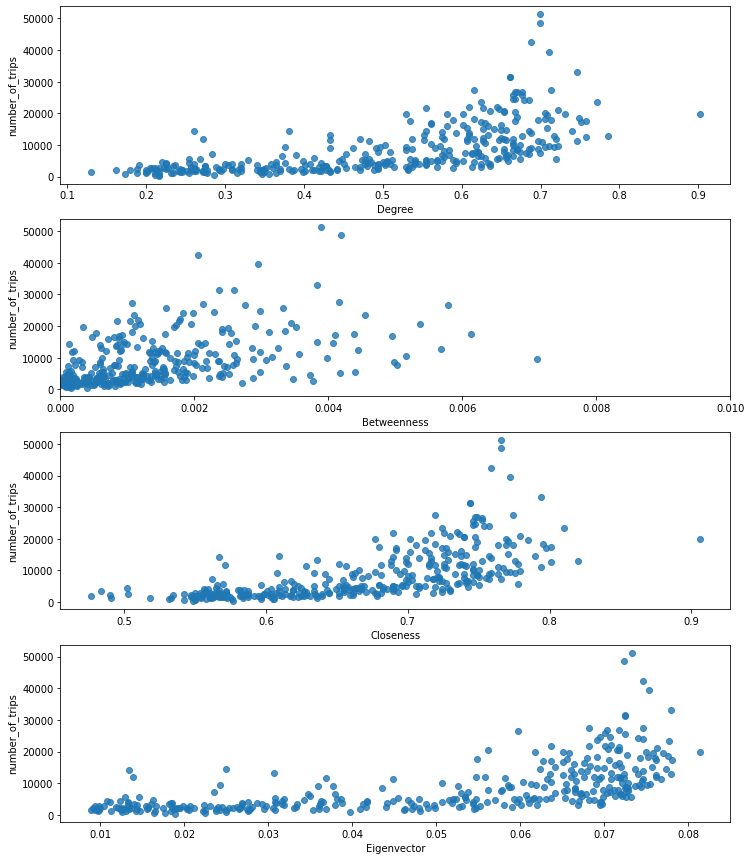

In [36]:
fig, ax = plt.subplots(4,1,figsize=(12,15))    
sns.regplot(x="Degree", y="number_of_trips", data=df, fit_reg=False, ax = ax[0])
g = sns.regplot(x="Betweenness", y="number_of_trips", data=df, fit_reg=False, ax = ax[1])
g.set(xlim=(0, 0.01))
sns.regplot(x="Closeness", y="number_of_trips", data=df, fit_reg=False, ax = ax[2])
sns.regplot(x="Eigenvector", y="number_of_trips", data=df, fit_reg=False, ax = ax[3])



In [37]:
# Visualize correlation matrix
corr = df.corr()
corr.style.background_gradient(cmap='coolwarm') 


,number_of_trips,Betweenness,Degree,Closeness,Eigenvector
number_of_trips,1.000000,0.292122,0.641672,0.649340,0.624129
Betweenness,0.292122,1.000000,0.436733,0.470261,0.335524
Degree,0.641672,0.436733,1.000000,0.993722,0.972420
Closeness,0.649340,0.470261,0.993722,1.000000,0.961956
Eigenvector,0.624129,0.335524,0.972420,0.961956,1.000000


In [23]:
# Computing VIF to check multicollinearity if VIF > 5 

# the independent variables set
X = df[['Closeness', 'Eigenvector', 'Degree', 'Betweenness']] 
# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                          for i in range(len(X.columns))]
  
print(vif_data)

       feature         VIF
0    Closeness   52.712962
1  Eigenvector  128.606222
2       Degree  308.908065
3  Betweenness    1.875633


In [24]:
df1 = df.copy()
#  Normalized features
cols_to_norm = ['Betweenness', 'Degree', 'Closeness',"Eigenvector"]

df1[cols_to_norm] = StandardScaler().fit_transform(df1[cols_to_norm])
df1 = pd.DataFrame(df1)

/opt/miniconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:1969: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


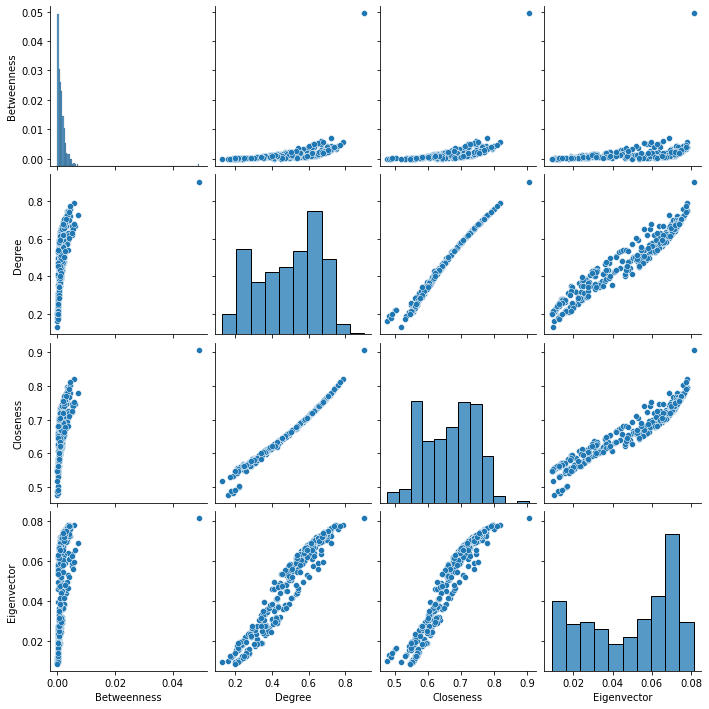

347


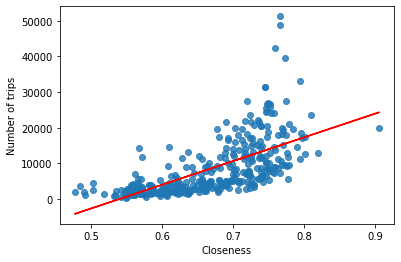

Parameters:
w0: -35763.639081
w1: 66355.541765
R2: 0.421643


In [40]:
#### Some scatter plots
cols = ['Betweenness', 'Degree', 'Closeness', 'Eigenvector']
sns.pairplot(df[cols], size=2.5)
plt.show()

# change to df1 to have normalized values for X 
y = df.iloc[:,1].values  

X = df.iloc[:,[4,]].values  # simple linear regression with Closeness
 
print(X.size)

### Plot 
g = sns.regplot(x=X, y=y, fit_reg=False)



### Linear Regression
reg = linear_model.LinearRegression()
reg.fit(X,y)
plt.plot(X, reg.predict(X), color='red')

### Labels
plt.xlabel('Closeness')
plt.ylabel('Number of trips')
plt.show()

# Coefficients and R2
print('Parameters:')
print('w0: %f'%reg.intercept_)
print('w1: %f'%reg.coef_[0])
print('R2: %f'%metrics.r2_score(y,reg.predict(X)))



## Polynomial Regression 

In [25]:
from sklearn.model_selection import train_test_split
# split into train and test
df_train, df_test = train_test_split(df1, 
                                     train_size = 0.7, 
                                     test_size = 0.3, 
                                     random_state = 10)
print(len(df_train))
print(len(df_test))

242
105


In [26]:
X_train = df_train[['Closeness']]
X_train = X_train.values.reshape(-1, 1)
y_train = df_train['number_of_trips']

X_test = df_test[['Closeness']]
X_test = X_test.values.reshape(-1, 1)
y_test = df_test['number_of_trips']

In [43]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
# fit multiple polynomial features
degrees = [1, 2, 3,4]

y_train_pred = np.zeros((len(X_train), len(degrees)))
y_test_pred = np.zeros((len(X_test), len(degrees)))

for i, degree in enumerate(degrees):
    
    # make pipeline: create features, then feed them to linear_reg model
    model = make_pipeline(PolynomialFeatures(degree), LinearRegression())
    model.fit(X_train, y_train)
    

    y_train_pred[:, i] = model.predict(X_train)
    y_test_pred[:, i] = model.predict(X_test)

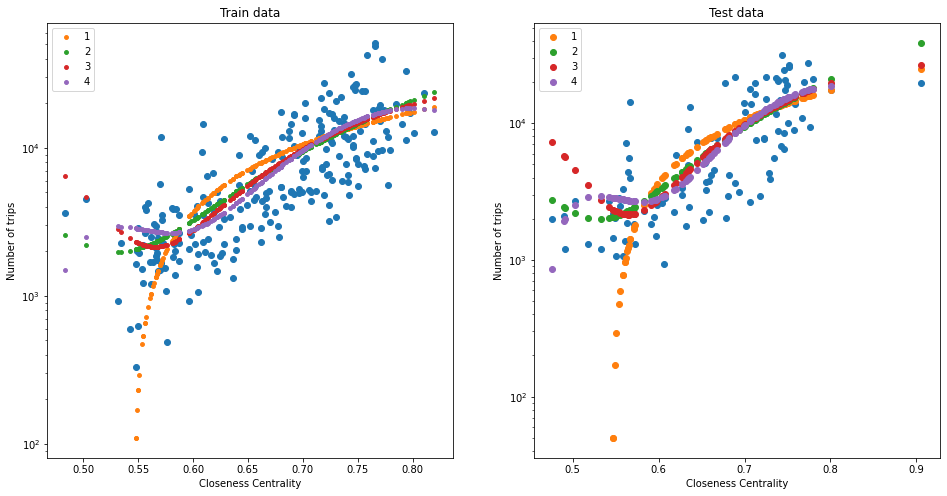

In [44]:
plt.figure(figsize=(16, 8))

# train data
plt.subplot(121)
plt.scatter(X_train, y_train)
plt.yscale('log')
plt.xlabel('Closeness Centrality')
plt.ylabel('Number of trips')
plt.title("Train data")
for i, degree in enumerate(degrees):    
    plt.scatter(X_train, y_train_pred[:, i], s=15, label=str(degree))
    plt.legend(loc='upper left')
    
# test data
plt.subplot(122)
plt.scatter(X_test, y_test)
plt.yscale('log')
plt.xlabel('Closeness Centrality')
plt.ylabel('Number of trips')
plt.title("Test data")
for i, degree in enumerate(degrees):    
    plt.scatter(X_test, y_test_pred[:, i], label=str(degree))
    plt.legend(loc='upper left')

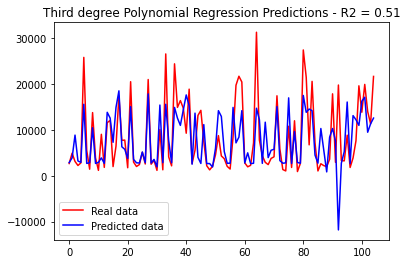

In [45]:
y_test = y_test.values.reshape(-1, 1)
plt.plot(y_test, color = 'red', label = 'Real data')
plt.plot(y_test_pred[:,3], color = 'blue', label = 'Predicted data')
plt.title('Third degree Polynomial Regression Predictions - R2 = 0.51')
plt.legend()
plt.show()

In [47]:
# compare r2 for train and test sets (for all polynomial fits)
import sklearn
print("R-squared values: \n")

for i, degree in enumerate(degrees):
    train_r2 = round(sklearn.metrics.r2_score(y_train, y_train_pred[:, i]), 4)
    test_r2 = round(sklearn.metrics.r2_score(y_test, y_test_pred[:, i]), 4)
    print("Polynomial degree {0}: train score={1}, test score={2}".format(degree, 
                                                                         train_r2, 
                                                                         test_r2))

R-squared values: 

Polynomial degree 1: train score=0.4059, test score=0.4584
Polynomial degree 2: train score=0.4352, test score=0.4614
Polynomial degree 3: train score=0.4389, test score=0.5062
Polynomial degree 4: train score=0.445, test score=0.3667


## K-fold cross Validation for multiple linear regression

In [27]:
X_train1 = df_train[['Betweenness', 'Degree', 'Closeness', 'Eigenvector']]
#X_train = X_train.values.reshape(-1, 1)
y_train1 = df_train['number_of_trips']

X_test1 = df_test[['Betweenness', 'Degree', 'Closeness', 'Eigenvector']]
#X_test = X_test.values.reshape(-1, 1)
y_test1 = df_test['number_of_trips']

In [28]:

lm = LinearRegression()
scores = cross_val_score(lm, X_train1, y_train1, scoring='r2', cv=5)
scores

array([0.37481103, 0.44233275, 0.29858514, 0.38253963, 0.25668772])

In [29]:


folds = KFold(n_splits = 5, shuffle = True, random_state = 100)

#  specify range of hyperparameters to tune
hyper_params = [{'n_features_to_select': list(range(1, 5))}]


# perform grid search
#  specify model
lm = LinearRegression()
lm.fit(X_train1, y_train1)
rfe = RFE(lm)             

model_cv = GridSearchCV(estimator = rfe, 
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = folds, 
                        verbose = 1,
                        return_train_score=True)      


model_cv.fit(X_train1, y_train1)  

Fitting 5 folds for each of 4 candidates, totalling 20 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:    0.3s finished


GridSearchCV(cv=KFold(n_splits=5, random_state=100, shuffle=True),
             estimator=RFE(estimator=LinearRegression()),
             param_grid=[{'n_features_to_select': [1, 2, 3, 4]}],
             return_train_score=True, scoring='r2', verbose=1)

In [30]:
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.010716,0.001852,0.003870,0.001567,1,{'n_features_to_select': 1},0.443306,0.476548,0.444367,0.249913,...,0.421136,0.087609,1,0.393932,0.392859,0.397391,0.467986,0.387943,0.408022,0.030134
1,0.014615,0.008848,0.007258,0.006294,2,{'n_features_to_select': 2},0.448364,0.484249,0.420638,0.257214,...,0.419143,0.084482,2,0.397654,0.396167,0.405872,0.468977,0.393599,0.412454,0.028559
2,0.006625,0.002539,0.003411,0.000841,3,{'n_features_to_select': 3},0.438283,0.467980,0.420639,0.226549,...,0.407272,0.092960,3,0.400178,0.398583,0.406391,0.472643,0.393963,0.414352,0.029416
3,0.003356,0.000380,0.002307,0.000226,4,{'n_features_to_select': 4},0.435754,0.468575,0.421937,0.222042,...,0.404248,0.093124,4,0.402046,0.399548,0.407176,0.472841,0.396862,0.415694,0.028775


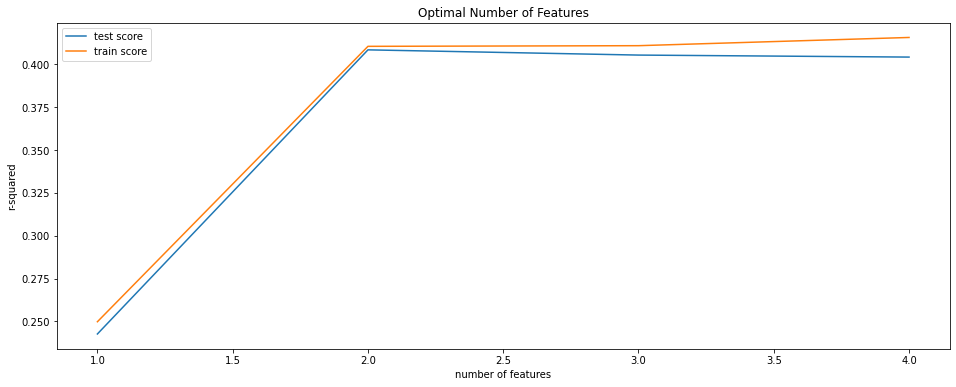

In [52]:
# plotting cv results
plt.figure(figsize=(16,6))

plt.plot(cv_results["param_n_features_to_select"], cv_results["mean_test_score"])
plt.plot(cv_results["param_n_features_to_select"], cv_results["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

In [31]:
# final model
n_features_optimal = 2

lm = LinearRegression()
lm.fit(X_train1, y_train1)

rfe = RFE(lm, n_features_to_select=n_features_optimal)             
rfe = rfe.fit(X_train1, y_train1)

# predict prices of X_test
y_pred1 = rfe.predict(X_test1)
r2 = sklearn.metrics.r2_score(y_test1, y_pred1)
print(r2)

0.44354169187943016


In [32]:
print(rfe.support_)
print ('coefficients',rfe.estimator_.coef_)


[False  True  True False]
coefficients [-5391.10758067 10777.84579965]


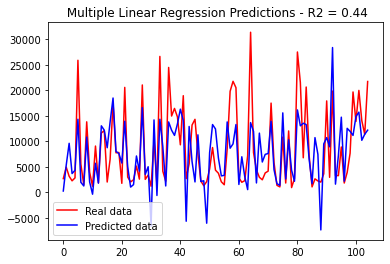

In [33]:
y_test1 = y_test1.values.reshape(-1, 1)
plt.plot(y_test1, color = 'red', label = 'Real data')
plt.plot(y_pred1, color = 'blue', label = 'Predicted data')
plt.title(' Multiple Linear Regression Predictions - R2 = 0.44')
plt.legend()
plt.show()

## Trying some improvements with SVM regression

In [34]:
X_train2 = df_train[[ 'Closeness']]
#X_train = X_train.values.reshape(-1, 1)
y_train2 = df_train['number_of_trips']

X_test2 = df_test[['Closeness']]
#X_test = X_test.values.reshape(-1, 1)
y_test2 = df_test['number_of_trips']

In [35]:
n_samples, n_features = 100, 2
np.random.seed(420)

parameters = {'kernel': ('linear', 'rbf','poly'), 'C':[100,500,8000,5000],'gamma': [1e-28,1e-27,1e-26,1e-30,1e-24,1e-23],'epsilon':[0.002,0.02,0.05,0.1,0.15,0.2]}
svr = svm.SVR()
clf = GridSearchCV(svr, parameters)
clf.fit(X_train2,y_train2)
clf.best_params_

y_pred2 = clf.predict(X_test2)

r2 = sklearn.metrics.r2_score(y_test2, y_pred2)
print(r2) # Best r^2 0.347



0.36543287884984965


In [59]:
clf.best_params_


{'C': 8000, 'epsilon': 0.2, 'gamma': 1e-28, 'kernel': 'linear'}

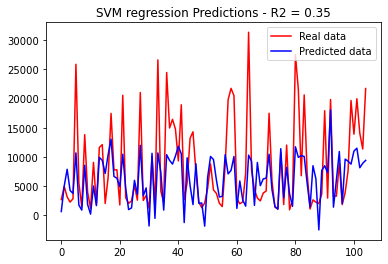

In [36]:
y_test2 = y_test2.values.reshape(-1, 1)
plt.plot(y_test2, color = 'red', label = 'Real data')
plt.plot(y_pred2, color = 'blue', label = 'Predicted data')
plt.title('SVM regression Predictions - R2 = 0.35')
plt.legend()
plt.show()

## Regression Tree

In [61]:
# create a regressor object
tree = tree.DecisionTreeRegressor() 
  
# fit the regressor with X and Y data with 1 variable, closeness
c = tree.fit(X_train2, y_train2)

In [62]:
# Low R^2, 0.20
y_pred3 = tree.predict(X_test2)

r22 = sklearn.metrics.r2_score(y_test2, y_pred3)
print(r22)

0.21009688855150388


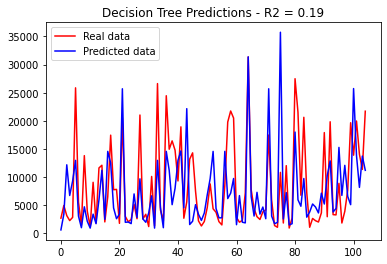

In [63]:
y_test2 = y_test2.reshape(-1, 1)
plt.plot(y_test2, color = 'red', label = 'Real data')
plt.plot(y_pred3, color = 'blue', label = 'Predicted data')
plt.title('Decision Tree Predictions - R2 = 0.19')
plt.legend()
plt.show()

## Random Forest

In [37]:
def evaluate(model, test_features, test_labels):
    predictions = model.predict(test_features)
    errors = abs(predictions - test_labels)
    mape = 100 * np.mean(errors / test_labels)
    accuracy = 100 - mape
    print('Model Performance')
    print('Average Error: {:0.4f} degrees.'.format(np.mean(errors)))
    print('Accuracy = {:0.2f}%.'.format(accuracy))
    
    return accuracy

In [38]:
param_grid = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100, 110],
    'max_features': [1, 1],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [100, 200, 300, 1000]
}
# Create a based model
rf = RandomForestRegressor()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 5, n_jobs = -1, verbose = 2)

base_model = RandomForestRegressor(n_estimators = 30, random_state = 100)
base_model.fit(X_train, y_train)
base_accuracy = evaluate(base_model, X_test, y_test)


Model Performance
Average Error: 4524.5762 degrees.
Accuracy = 31.16%.


In [39]:
rf = RandomForestRegressor()
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 5, n_jobs = -1, verbose = 2)
# Fit the grid search to the data
grid_search.fit(X_train, y_train)
grid_search.best_params_
{'bootstrap': True,
 'max_depth': 80,
 'max_features': 1,
 'min_samples_leaf': 5,
 'min_samples_split': 12,
 'n_estimators': 100}
best_grid = grid_search.best_estimator_
grid_accuracy = evaluate(best_grid, X_test, y_test)

print('Improvement of {:0.2f}%.'.format( 100 * (grid_accuracy - base_accuracy) / base_accuracy))


Fitting 5 folds for each of 288 candidates, totalling 1440 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   11.8s
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:   46.9s
[Parallel(n_jobs=-1)]: Done 357 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 640 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 1005 tasks      | elapsed:  5.3min


Model Performance
Average Error: 4108.0068 degrees.
Accuracy = 35.58%.
Improvement of 14.19%.


[Parallel(n_jobs=-1)]: Done 1440 out of 1440 | elapsed:  7.5min finished


## Neural Network Model

In [40]:
model = Sequential()
model.add(Dense(64, input_dim=3, kernel_initializer='normal', activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
#model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
#model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='linear'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                256       
                                                                 
 dense_1 (Dense)             (None, 32)                2080      
                                                                 
 dense_2 (Dense)             (None, 16)                528       
                                                                 
 dense_3 (Dense)             (None, 8)                 136       
                                                                 
 dense_4 (Dense)             (None, 1)                 9         
                                                                 
Total params: 3,009
Trainable params: 3,009
Non-trainable params: 0
_________________________________________________________________


In [41]:
X_train1 = df_train[["Closeness","Eigenvector","Degree"]]

y_train1 = df_train['number_of_trips']

X_test1 = df_test[["Closeness","Eigenvector","Degree"]]

y_test1 = df_test['number_of_trips']

In [42]:
model.compile(loss='mse', optimizer='adam', metrics=['mse','mae'])

In [43]:
X_train1.shape

(242, 3)

In [44]:
history = model.fit(X_train1, y_train1, epochs=300, batch_size=10,  verbose=0, validation_split=0.2)


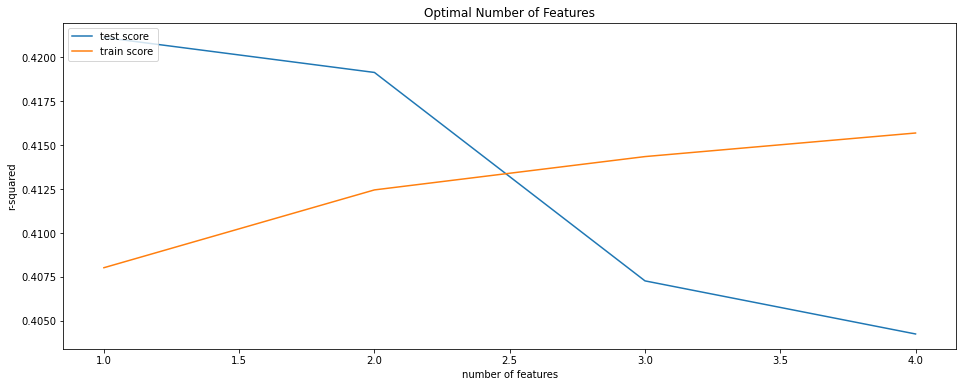

In [45]:
# plotting cv results
plt.figure(figsize=(16,6))

plt.plot(cv_results["param_n_features_to_select"], cv_results["mean_test_score"])
plt.plot(cv_results["param_n_features_to_select"], cv_results["mean_train_score"])
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
plt.legend(['test score', 'train score'], loc='upper left')

dict_keys(['loss', 'mse', 'mae', 'val_loss', 'val_mse', 'val_mae'])


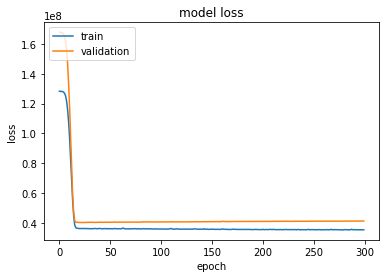

In [46]:
print(history.history.keys())
# "Loss"
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [47]:
y_pred= model.predict(X_test1)


In [48]:
r2 = sklearn.metrics.r2_score(y_test1, y_pred)
print(r2)

0.5131783309373454


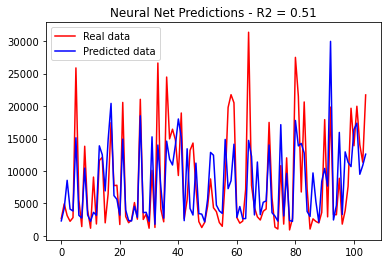

In [49]:
y_test1 = y_test1.values.reshape(-1, 1)
plt.plot(y_test1, color = 'red', label = 'Real data')
plt.plot(y_pred, color = 'blue', label = 'Predicted data')
plt.title('Neural Net Predictions - R2 = 0.51')
plt.legend()
plt.show()

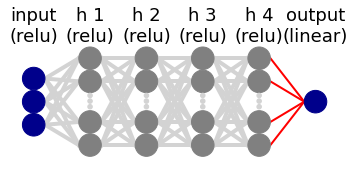

(<Figure size 432x288 with 1 Axes>, <AxesSubplot:>)

In [53]:

layersList = [
    {"title":"input\n(relu)", "units": 3, "color": "darkBlue"},
    {"title":"h 1\n(relu)", "units": 64},
    {"title":"h 2\n(relu)", "units": 32},
    {"title":"h 3\n(relu)", "units": 16},
    {"title":"h 4\n(relu)", "units": 8, "edges_color":"red", "edges_width":2},
    {"title":"output\n(linear)", "units": 1,"color": "darkBlue"},
]

NNV(layersList).render(save_to_file="my_example.png")
